In [ ]:
import numpy as np
import os, json, cv2, random, cv2, glob
import urllib.request
import PIL.Image as Image
from imutils import paths
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from skimage import io
from pathlib import Path
from tqdm import tqdm
from PIL import Image, ImageDraw
from shapely.geometry.polygon import Polygon

from collections import OrderedDict
import shutil
import logging

def convert_bool_uint8(image, n=0):
    #將image值map到0和255並轉成uint8
    image = image > n #mix all type caries to boolean
    image = image *1 #convert boolean to 0/255
    image = image.astype(np.uint8)
    return image

def json_handle(img_dir,numdata):

    #json_file = os.path.join(img_dir, "data.json")
    with open("data.json") as f:
        tm_text = json.load(f)

    dataset_dictst = []
    dataset_dictsv = []
	
    skip = 0

    for key,value in tqdm(tm_text.items()):
        if skip:
            skip = 0
            continue
			
        record = {}
        raw_data = tm_text[key]
		
        if(raw_data['filename'] == None):
            continue
        filename = raw_data['filename']
		
        oimg = io.imread(filename)
        height, width = oimg.shape[:2]
		
        url,filename = os.path.split(str(filename))
        filename, suffix = os.path.splitext(filename)

        if int(filename) >= numdata: 
            break
        elif int(filename) == 267:
            skip = 1#268 bug
		
        record["image_id"] = key
        record["height"] = height
        record["width"] = width
		
        cariescheck = 0
        objs = []
        #boxtxt = []
        caries = np.zeros((height, width),np.uint8)
		
        for anno in raw_data['regions']:
            if(anno == None):
                continue
            region = anno['region_attributes']

            temp = Image.new("L", [width, height,], 0)

            if 'detail' in region and region['detail'] == 'caries':
                cariescheck = 1
                px = anno['shape_attributes']['all_points_x']
                py = anno['shape_attributes']['all_points_y']
                if(len(px) < 3):
                    continue
					
                combined = list(map(tuple, np.vstack((px, py)).T))
                ImageDraw.Draw(temp).polygon(combined, outline=1, fill=1)
                temp = np.array(temp)
                temp = convert_bool_uint8(temp)
				
                if (np.count_nonzero(temp)/(width*height)) >= 0.055:
                    continue
                if (int(np.min(px))/int(np.max(px))) <= 0.04:
                    continue

                caries = caries + temp
					

            else:
                continue
		
        
        if (cariescheck == 0): 
            if random.random() > 0.98: 
              cv2.imwrite("data/answer/"+str(filename)+".png", caries) 
              cv2.imwrite("data/test/"+str(filename)+".png", oimg) 
            continue
			
        
        caries = convert_bool_uint8(caries) #將caries值map到0和255並轉成uint8

        
        if  random.random() > 0.1: 
            cv2.imwrite("data/train/label/"+str(filename)+".png", caries) 
            cv2.imwrite("data/train/image/"+str(filename)+".png", oimg) 
        else: 
            cv2.imwrite("data/answer/"+str(filename)+".png", caries) 
            cv2.imwrite("data/test/"+str(filename)+".png", oimg) 
        

if __name__ == '__main__': #防止調用的時候這一行被運行

    outdir_label = r"data/train/label"
    outdir_image = r"data/train/image"
    outdir_answer = r"data/answer"
    outdir_test = r"data/test"

    Exist = True
    while os.path.exists(outdir_label):
        os.rename(outdir_label, outdir_label + r"_delete")
        os.rename(outdir_image, outdir_image + r"_delete")
        os.rename(outdir_answer, outdir_answer + r"_delete")
        os.rename(outdir_test, outdir_test + r"_delete")
        if Exist:
            shutil.rmtree(outdir_label + r"_delete")
            shutil.rmtree(outdir_image + r"_delete")
            shutil.rmtree(outdir_answer + r"_delete") 
            shutil.rmtree(outdir_test + r"_delete")
            Exist = False
    os.mkdir(outdir_label)
    os.mkdir(outdir_image)
    os.mkdir(outdir_answer)
    os.mkdir(outdir_test)
	
    json_handle("FastAI",9000)#2000

100%|█████████▉| 8672/8700 [54:44<00:10,  2.64it/s]


**> 隨機分配training和validation資料**

In [ ]:
from tqdm import tqdm
ipath = glob.glob("data/train/image/*")
lpath = glob.glob("data/train/label/*")

i=0
'''
for each_path in tqdm(ipath):
  image = cv2.imread(each_path)#读取文件
  url,filename2 = os.path.split(each_path)
  filename, suffix = os.path.splitext(filename2)
  cv2.imwrite("data/train2/image/"+str(filename)+".png", image) 
'''
for each_path in tqdm(lpath):
  i+=1
  if  i<950: 
    continue
  image = cv2.imread(each_path)#读取文件
  url,filename2 = os.path.split(each_path)
  filename, suffix = os.path.splitext(filename2)
  image[image==255]=1
  cv2.imwrite("data/train2/label/"+str(filename)+".png", image) 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd drive/MyDrive/FastAI/

/content/drive/MyDrive/FastAI


In [ ]:
pip install fastbook --upgrade

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
import torch
import glob
from pathlib import Path
from fastai.basics import *
from fastai.callback.all import *
from fastai.vision import *
from fastai.vision.all import *
from nbdev.showdoc import *
from fastai.vision.widgets import *
import PIL.Image
#if doesnt work !pip install fastbook --upgrade

In [ ]:
    path = Path('data/train')
	
    path_img = get_image_files(path/'image')
    path_lbl = get_image_files(path/'label')
	
    get_y_fn = lambda x: path/'label'/f'{x.stem}.png'

> codes.txt

Background

Caries

Void

data/train/image/1131.png
PILMask mode=L size=627x805
['Background' 'Caries' 'Void']


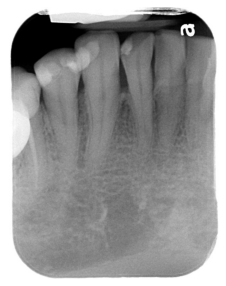

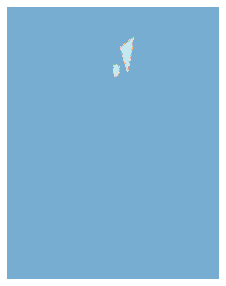

In [ ]:
print(path_img[110])
imgtest = path_img[110]
img = PILImage.create(imgtest)
img.show(figsize=(5,5))
mask = PILMask.create(get_y_fn(imgtest))
mask.show(figsize=(5,5), alpha=0.6)
print(mask)
src_size = np.array(mask.shape[1:])
src_size,tensor(mask)
codes = np.loadtxt(path/'codes.txt', dtype=str)
print(codes)

In [ ]:
def get_y(o): return path/'label'/f'{o.stem}.png'
camvid = DataBlock(blocks=(ImageBlock, MaskBlock(codes)), #MaskBlock(['0','1'])),   
                   get_items=get_image_files,
                   splitter=RandomSplitter(0.005),
                   get_y=get_y,
                   item_tfms=Resize(512, method='pad',pad_mode='zeros'), #Resize can also be passed inside of batch_tfms #416 ori
                   batch_tfms=[*aug_transforms(), Normalize.from_stats(*imagenet_stats)])

#Augmentation

In [ ]:
dls = camvid.dataloaders(path/"image", bs=4, path=path)

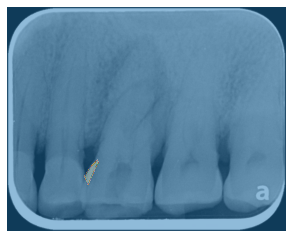

In [ ]:
show_at(dls.train_ds, 1)

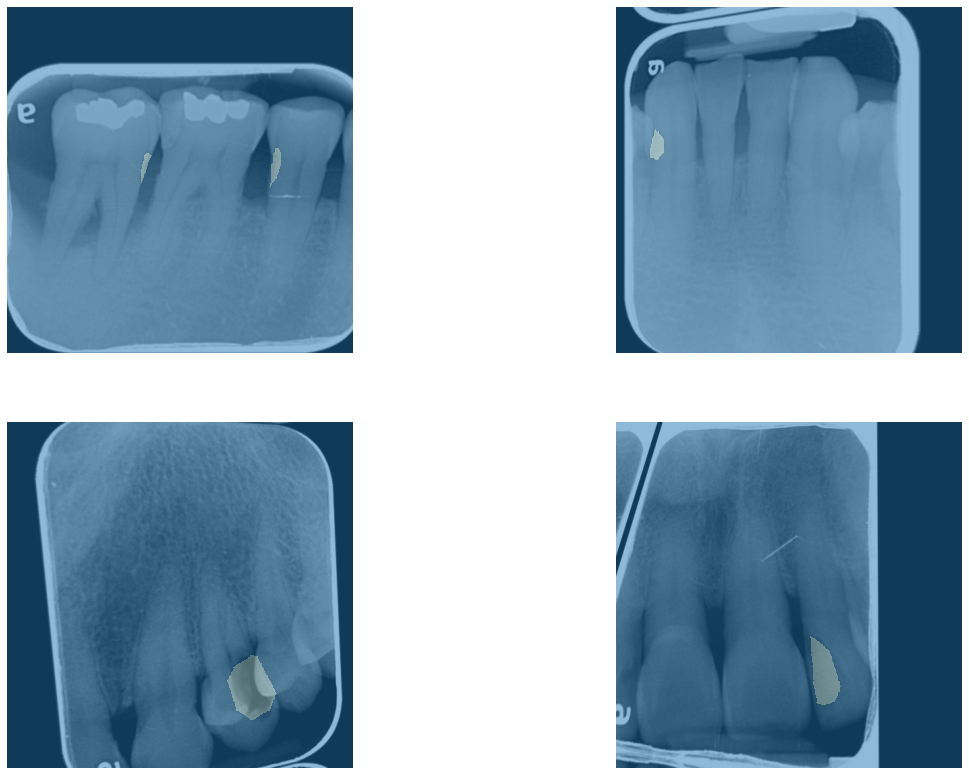

In [ ]:
b = dls.train.one_batch()
b = dls.train.decode(b)
b[0].shape, b[1].shape
dls.show_batch(max_n=4, figsize=(20,14),vmin=0, vmax=1)

In [ ]:
name2id = {v:k for k,v in enumerate(codes)}
void_code = name2id['Void']

def acc_camvid(input, target):
    target = target.squeeze(1)
    mask = target != void_code
    return (input.argmax(dim=1)[mask]==target[mask]).float().mean()

In [ ]:
wd=1e-2
dls.vocab = codes
learn = unet_learner(dls, resnet34, self_attention=True, metrics=acc_camvid, wd=1e-2)

#Train by resnet34

Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth


  0%|          | 0.00/83.3M [00:00<?, ?B/s]

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


In [ ]:
learn.loss_func

FlattenedLoss of CrossEntropyLoss()

In [ ]:
learn.model

SuggestedLRs(minimum=0.0013182567432522773, steep=2.511886486900039e-05, slide=0.0014454397605732083, valley=7.585775892948732e-05)

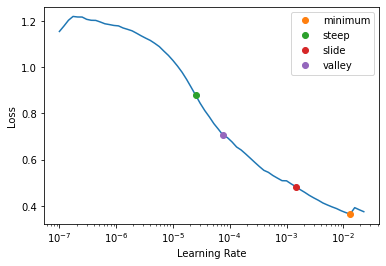

In [ ]:
#learn.lr_find()
learn.lr_find(suggest_funcs=(minimum, steep, slide, valley))

In [ ]:
torch.cuda.empty_cache()

In [ ]:
lr = 1e-05
learn.fit_one_cycle(11, slice(lr), pct_start=0.9, wd=wd)

epoch,train_loss,valid_loss,acc_camvid,time
0,0.152823,0.065202,0.986869,11:56
1,0.053339,0.025434,0.997601,09:43
2,0.032269,0.013231,0.998141,09:41
3,0.027093,0.012701,0.998148,09:40
4,0.026570,0.011074,0.998156,09:41
5,0.024628,0.012943,0.998156,09:41
6,0.023406,0.010574,0.998156,09:41
7,0.022291,0.010257,0.998156,09:41
8,0.021500,0.010192,0.998156,09:41
9,0.020223,0.009294,0.998156,09:41


In [ ]:
learn.save('stage-1')

Path('data/train/models/stage-1.pth')

In [ ]:
learn.load('stage-1');

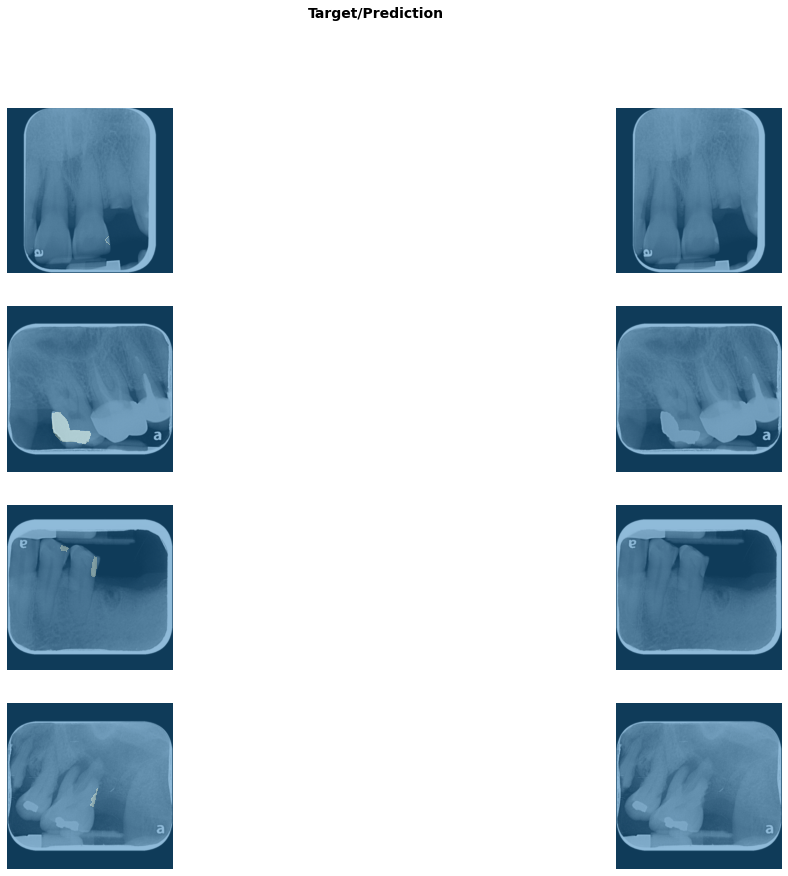

In [ ]:
learn.show_results(max_n=4, figsize=(20,14),vmin=0, vmax=1)

In [ ]:
learn.unfreeze()

SuggestedLRs(minimum=1.4454397387453355e-06, steep=1.5848931980144698e-06, slide=0.0012022644514217973, valley=4.786300905834651e-06)

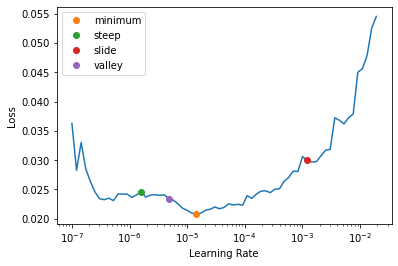

In [ ]:
learn.lr_find(suggest_funcs=(minimum, steep, slide, valley))

In [ ]:
learn.fit_one_cycle(10, slice(1e-6,1e-5), pct_start=0.8, wd=wd)

epoch,train_loss,valid_loss,acc_camvid,time
0,0.020866,0.034020,0.990165,10:14
1,0.019023,0.036043,0.990023,10:01
2,0.019534,0.038520,0.989829,10:01
3,0.019934,0.033359,0.990527,10:01
4,0.019563,0.037711,0.989888,10:01
5,0.019214,0.030550,0.990945,10:01
6,0.018601,0.028974,0.991153,10:01
7,0.019021,0.039483,0.989926,10:00
8,0.017266,0.031772,0.990695,10:01
9,0.016591,0.035101,0.990652,09:57


In [ ]:
learn.save('stage-2')

Path('data/train/models/stage-2.pth')

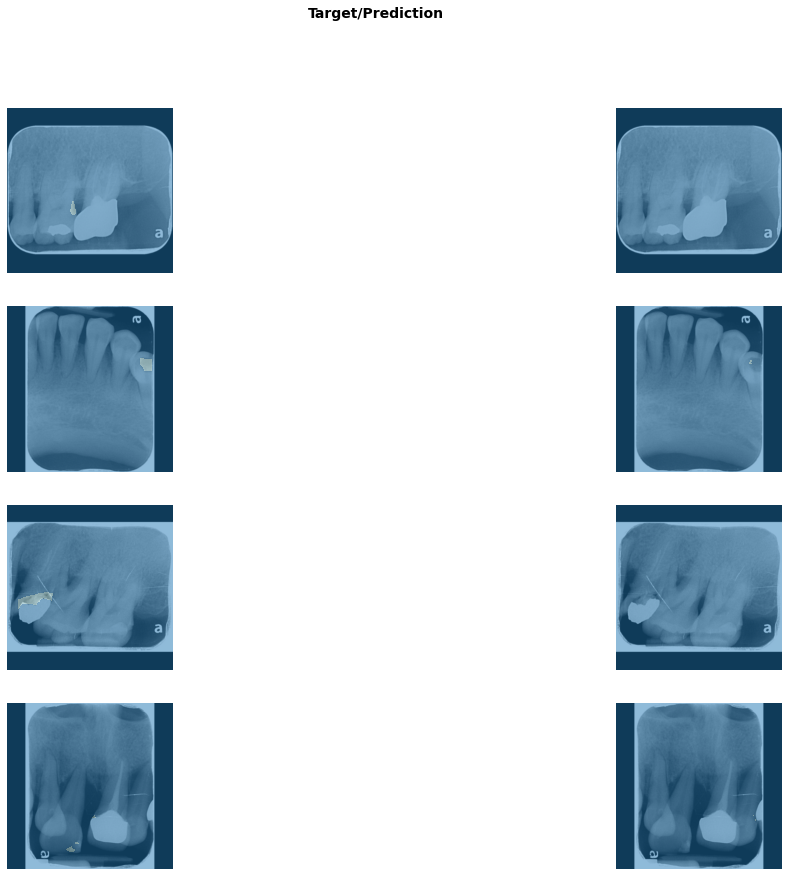

In [ ]:
learn.load('stage-2');
learn.show_results(max_n=4, figsize=(20,14),vmin=0, vmax=1)

In [ ]:
learn.unfreeze()

SuggestedLRs(minimum=3.981071586167673e-07, steep=6.309573450380412e-07, slide=0.0004786300996784121, valley=4.786300905834651e-06)

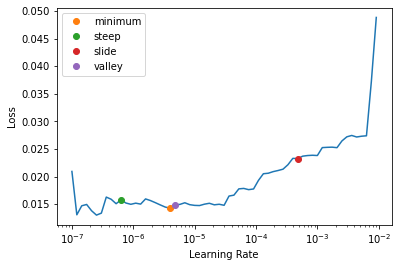

In [ ]:
learn.lr_find(suggest_funcs=(minimum, steep, slide, valley))

In [ ]:
learn.fit_one_cycle(10, slice(6e-7,4e-6), pct_start=0.8, wd=wd)

epoch,train_loss,valid_loss,acc_camvid,time
0,1.221158,1.108755,0.575024,6:09:55


In [ ]:
learn.save('stage-3')

Path('data/train/models/stage-3.pth')

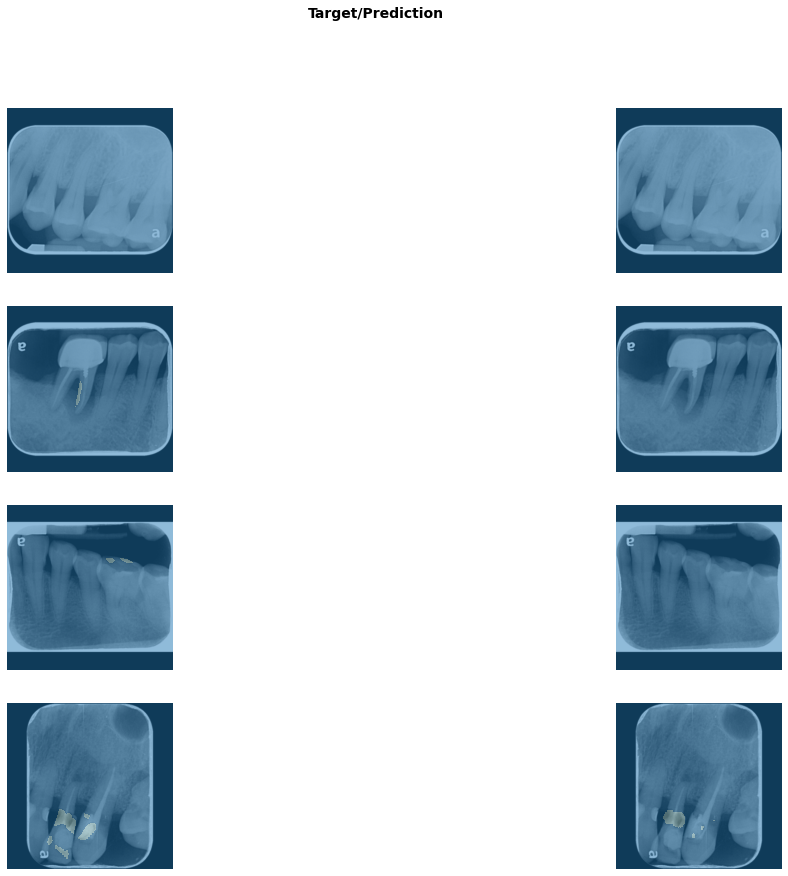

In [ ]:
learn.load('stage-3old');
learn.show_results(max_n=4, figsize=(20,14),vmin=0, vmax=1)

In [ ]:
from skimage import feature
import os
import pickle
import cv2
import numpy as np
import matplotlib.pyplot as plt
import glob
import shutil
import torch, torchvision
from skimage import io
import json
import requests
from pathlib import Path
import urllib
from PIL import Image, ImageDraw
import tensorflow as tf
import logging
from tqdm import tqdm

def convert_bool_uint8(image, n=0,cvt=True):
    #將image值map到0和255並轉成uint8
    image = image > n #mix all type caries to boolean
    if cvt:
      image = image *1 #convert boolean to 0/255
      image = image.numpy()
    else:
      image = image *100
    image = image.astype(np.uint8)
    return image

def predictt(filename):
  ipath = glob.glob("data/test/*")
  TTP = 0
  FFP = 0
  includep = 0
  emptyp = 0

  skip = -1

  for each_path in tqdm(ipath):
    skip += 1
    if skip > 180:
      break

    TP=0
    FP=0 
    ip=0 
    ep=0

    img = PILImage.create(each_path)
    url,filename2 = os.path.split(each_path)
    filename, suffix = os.path.splitext(filename2)

    outputs = learn.predict(img)
    cm_hot = plt.get_cmap('tab10')
    masked = outputs[0].data
    im = np.array(masked)
    im = np.squeeze(im)
    im = cm_hot(im) 
    im = PIL.Image.fromarray((im*255).astype('uint8'))

    background=img.convert("RGBA")
    overlay=im.convert("RGBA")
    background=background.resize((img.shape[1],img.shape[0]))
    overlay=overlay.resize((img.shape[1],img.shape[0]))

    TP, FP, ip, ep = maskcheck(filename,masked,background)

    new_img = Image.blend(background, overlay, 0.5)
    plt.imshow(new_img)
    plt.axis('off')
    plt.show()

    TTP += TP
    FFP += FP
    includep += ip
    emptyp += ep

  if (TTP == 0) and (FFP ==0):
    FFPnz = 1
  else:
    FFPnz = FFP

  print(' ')
  print('----------------------------------------------------------------------------')
  print(f'	> Num {TTP+FFP} -- TP: {TTP} - FP: {FFP} - include: {includep} - empty: {emptyp}')
  print('----------------------------------------------------------------------------')
  print(" > Accuracy: %.2f%%"% ((TTP/(TTP+FFPnz))*100))
  print('----------------------------------------------------------------------------')

def maskcheck(filename,mask,img):
    mask = convert_bool_uint8(mask)
    answer = cv2.imread("data/answer/"+str(filename)+".png")

    cm_hot = plt.get_cmap('tab10')
    overlay = answer
    overlay = np.array(cv2.cvtColor(overlay, cv2.COLOR_BGR2GRAY))
    overlay = np.squeeze(overlay)
    overlay = cm_hot(overlay) 
    overlay = PIL.Image.fromarray((overlay*255).astype('uint8'))
    overlay = overlay.convert("RGBA")
    overlay=overlay.resize((img.shape[1],img.shape[0]))

    answer = cv2.resize(cv2.cvtColor(answer, cv2.COLOR_BGR2GRAY), (mask.shape[1],mask.shape[0]))
    answer = convert_bool_uint8(answer,cvt=False)

    new_img = Image.blend(img, overlay, 0.5)
    plt.imshow(new_img)
    plt.axis('off')
    plt.show()

    cnts = []
    cnts = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)#mask輪廓
    cnts = cnts[0] if len(cnts) == 2 else cnts[1]
    answerarea = []
    answerarea = cv2.findContours(answer, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)#mask輪廓
    answerarea = answerarea[0] if len(answerarea) == 2 else answerarea[1]
    
    TP = 0
    FP = len(cnts)
    checkedp = 0
    emptyp = len(answerarea)

    #255 correct

    for cc in cnts:
        check = np.zeros(mask.shape, dtype=np.uint8)
        cv2.fillPoly(check, [cc], [100,100,100])

        if np.count_nonzero(check)< 10:
          FP -= 1
          continue
        if np.count_nonzero((check+answer)>=101)>0:
            TP += 1

    FP = FP - TP
    checkedp = TP
    emptyp = emptyp - TP
    print(">>>>>>>>>>>>> TP:",TP,"  FP:" ,FP," gotP:",checkedp," emptyP:",emptyp)
    return TP, FP, checkedp, emptyp


  0%|          | 0/262 [00:00<?, ?it/s]

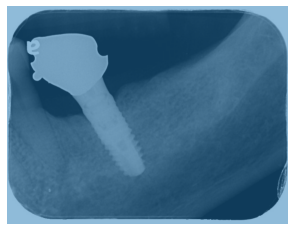

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


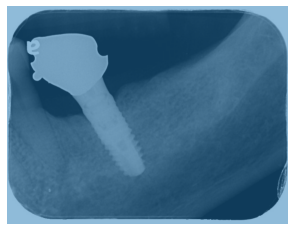

  0%|          | 1/262 [00:07<32:51,  7.55s/it]

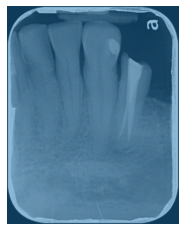

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 0


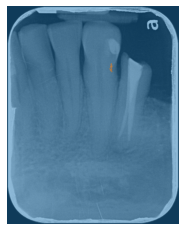

  1%|          | 2/262 [00:15<33:03,  7.63s/it]

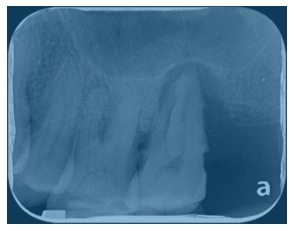

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


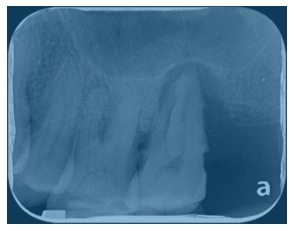

  1%|          | 3/262 [00:22<32:20,  7.49s/it]

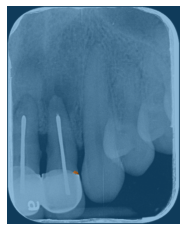

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


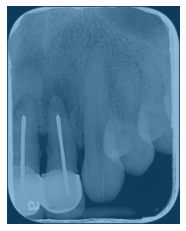

  2%|▏         | 4/262 [00:29<31:42,  7.37s/it]

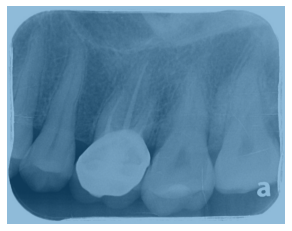

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


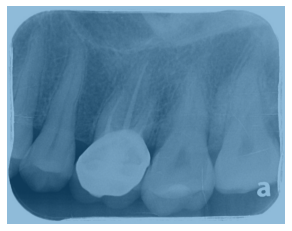

  2%|▏         | 5/262 [00:37<31:26,  7.34s/it]

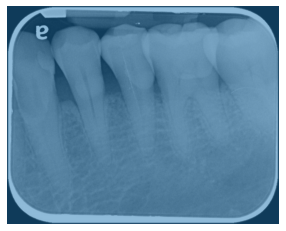

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


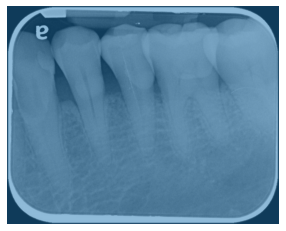

  2%|▏         | 6/262 [00:44<31:30,  7.39s/it]

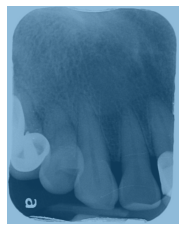

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


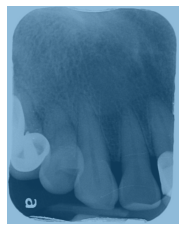

  3%|▎         | 7/262 [00:51<31:17,  7.36s/it]

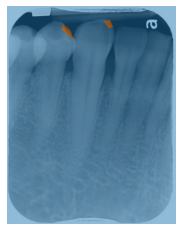

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 2


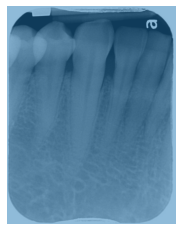

  3%|▎         | 8/262 [00:59<30:54,  7.30s/it]

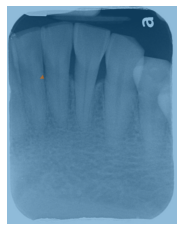

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


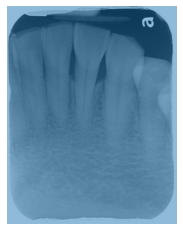

  3%|▎         | 9/262 [01:06<31:02,  7.36s/it]

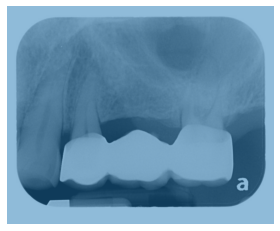

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


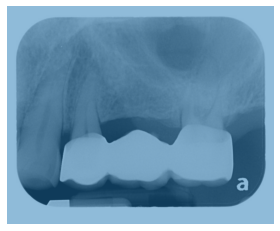

  4%|▍         | 10/262 [01:13<30:43,  7.31s/it]

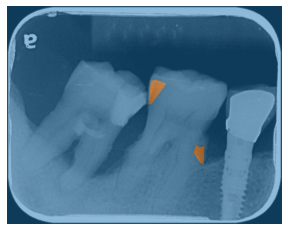

>>>>>>>>>>>>> TP: 0   FP: 3  gotP: 0  emptyP: 2


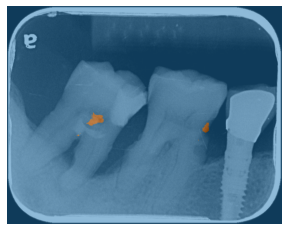

  4%|▍         | 11/262 [01:21<30:50,  7.37s/it]

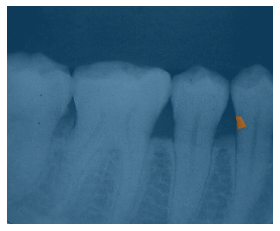

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


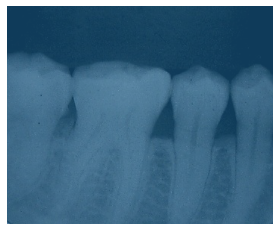

  5%|▍         | 12/262 [01:28<30:29,  7.32s/it]

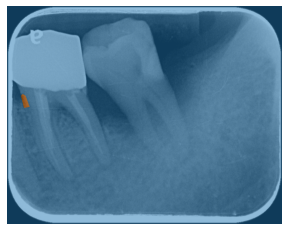

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


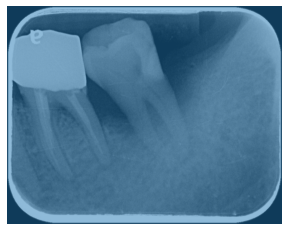

  5%|▍         | 13/262 [01:36<30:49,  7.43s/it]

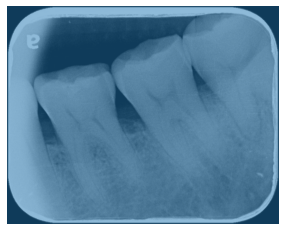

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


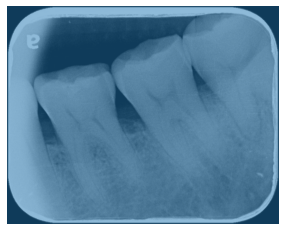

  5%|▌         | 14/262 [01:43<30:38,  7.41s/it]

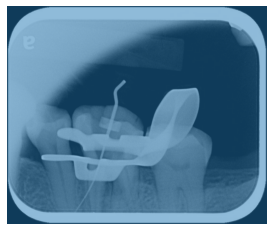

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


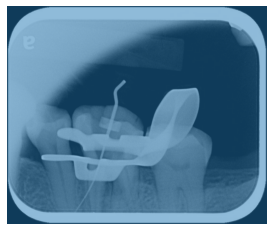

  6%|▌         | 15/262 [01:51<30:47,  7.48s/it]

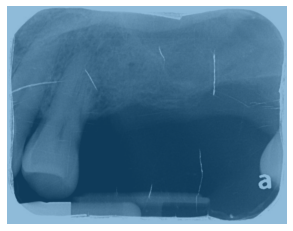

>>>>>>>>>>>>> TP: 0   FP: 2  gotP: 0  emptyP: 0


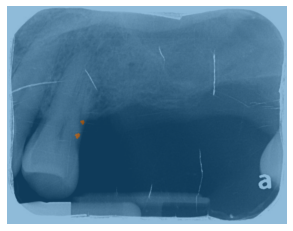

  6%|▌         | 16/262 [01:58<30:43,  7.49s/it]

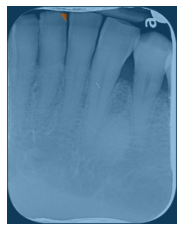

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


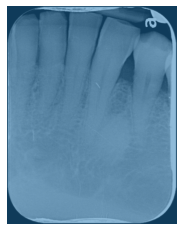

  6%|▋         | 17/262 [02:05<30:24,  7.45s/it]

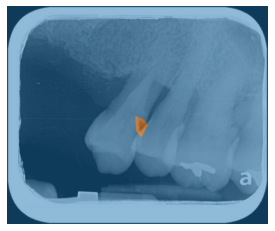

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


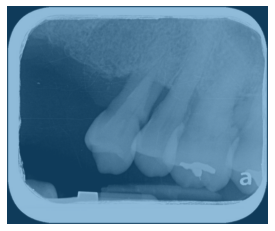

  7%|▋         | 18/262 [02:13<30:50,  7.58s/it]

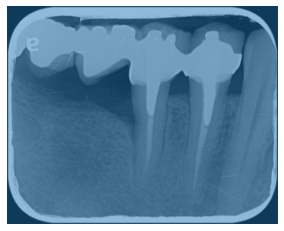

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


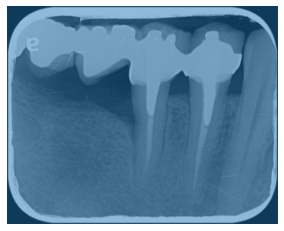

  7%|▋         | 19/262 [02:21<30:31,  7.54s/it]

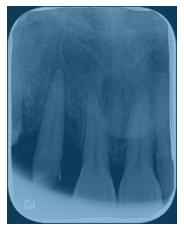

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 0


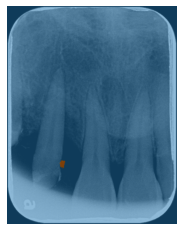

  8%|▊         | 20/262 [02:29<30:38,  7.60s/it]

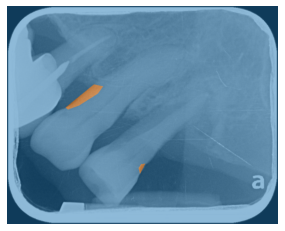

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 2


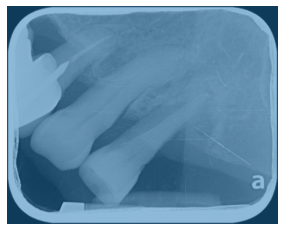

  8%|▊         | 21/262 [02:37<31:08,  7.75s/it]

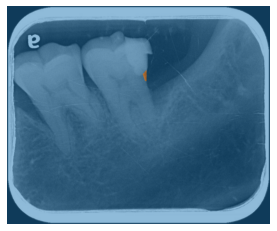

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


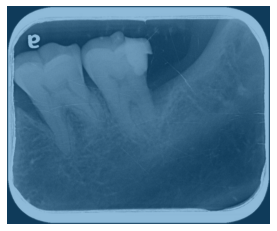

  8%|▊         | 22/262 [02:44<30:59,  7.75s/it]

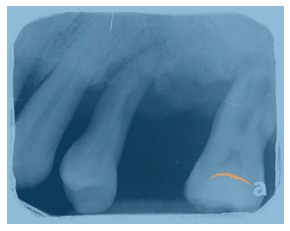

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


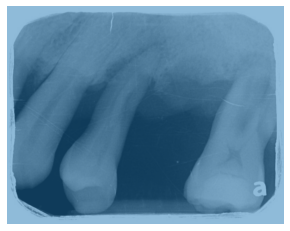

  9%|▉         | 23/262 [02:52<31:15,  7.85s/it]

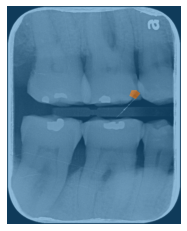

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


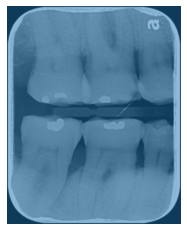

  9%|▉         | 24/262 [03:00<30:49,  7.77s/it]

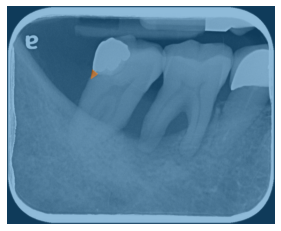

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


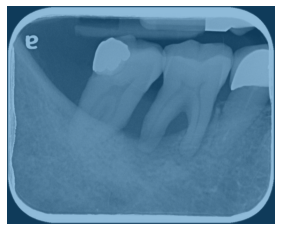

 10%|▉         | 25/262 [03:08<30:48,  7.80s/it]

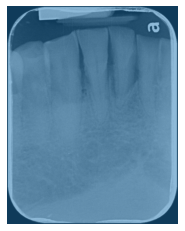

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


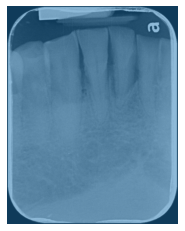

 10%|▉         | 26/262 [03:16<30:28,  7.75s/it]

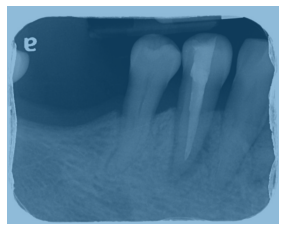

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


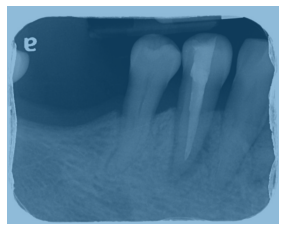

 10%|█         | 27/262 [03:23<30:10,  7.70s/it]

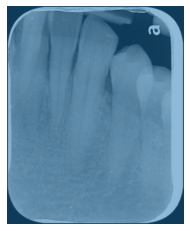

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


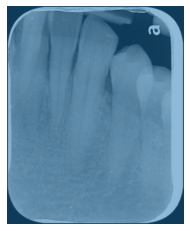

 11%|█         | 28/262 [03:31<30:44,  7.88s/it]

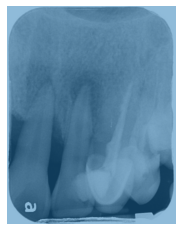

>>>>>>>>>>>>> TP: 0   FP: 2  gotP: 0  emptyP: 0


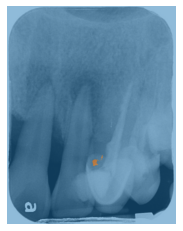

 11%|█         | 29/262 [03:39<30:22,  7.82s/it]

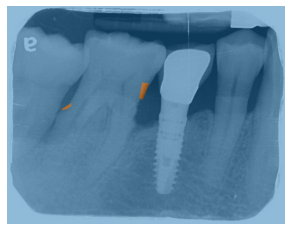

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 2


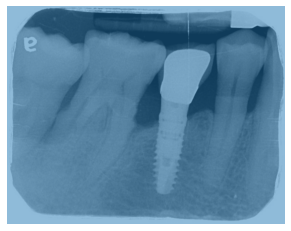

 11%|█▏        | 30/262 [03:47<30:24,  7.86s/it]

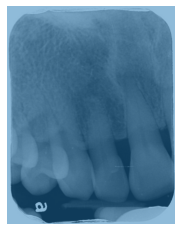

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


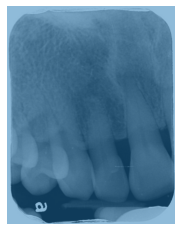

 12%|█▏        | 31/262 [03:55<30:36,  7.95s/it]

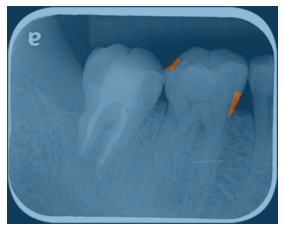

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 2


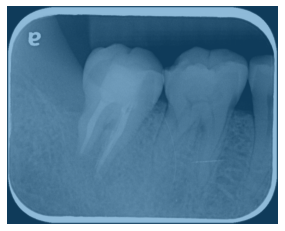

 12%|█▏        | 32/262 [04:03<30:17,  7.90s/it]

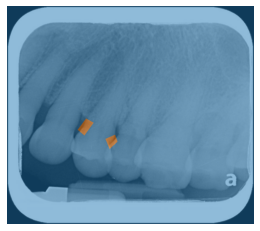

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 2


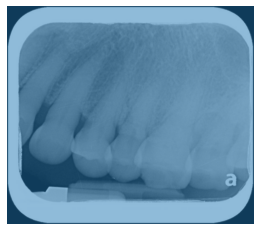

 13%|█▎        | 33/262 [04:11<30:03,  7.87s/it]

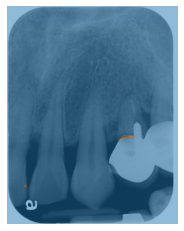

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 2


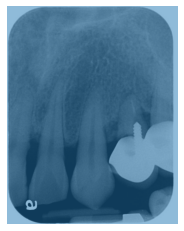

 13%|█▎        | 34/262 [04:18<29:36,  7.79s/it]

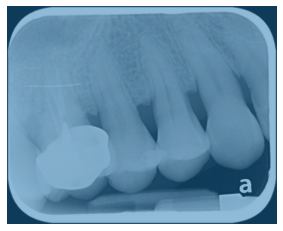

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


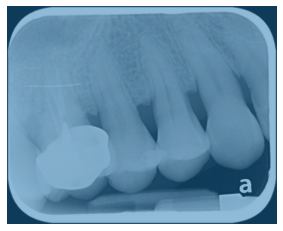

 13%|█▎        | 35/262 [04:26<29:25,  7.78s/it]

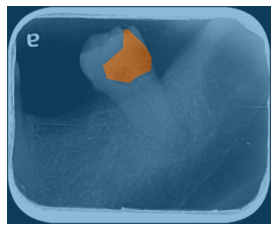

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


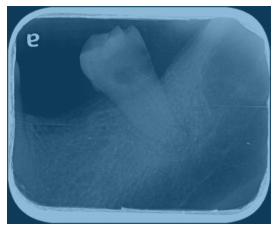

 14%|█▎        | 36/262 [04:34<29:15,  7.77s/it]

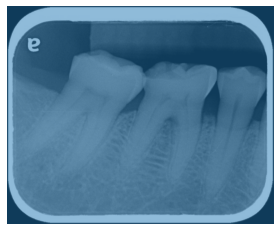

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


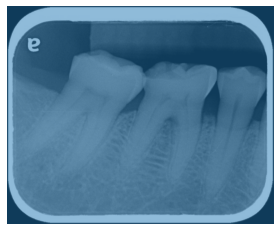

 14%|█▍        | 37/262 [04:42<29:02,  7.74s/it]

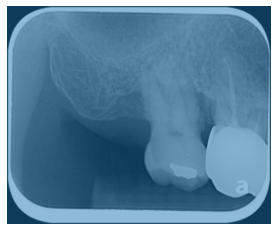

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


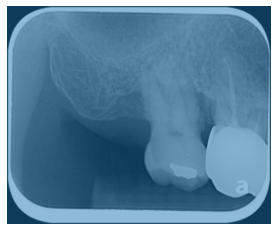

 15%|█▍        | 38/262 [04:49<28:57,  7.76s/it]

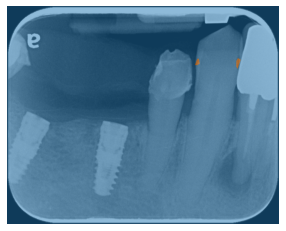

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 2


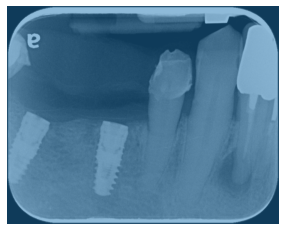

 15%|█▍        | 39/262 [04:57<29:00,  7.81s/it]

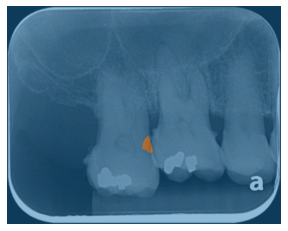

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


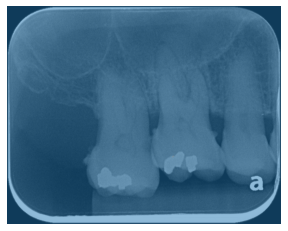

 15%|█▌        | 40/262 [05:05<28:36,  7.73s/it]

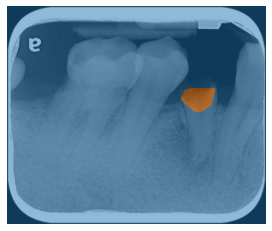

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


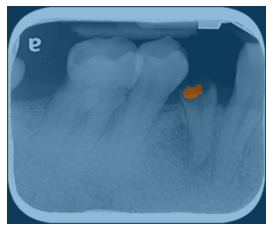

 16%|█▌        | 41/262 [05:13<28:57,  7.86s/it]

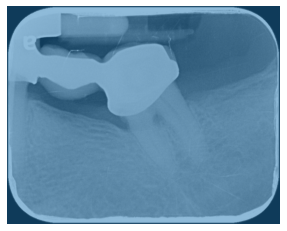

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


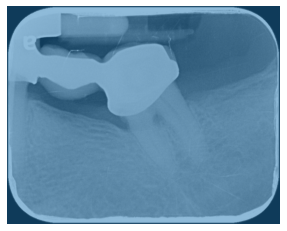

 16%|█▌        | 42/262 [05:21<28:52,  7.87s/it]

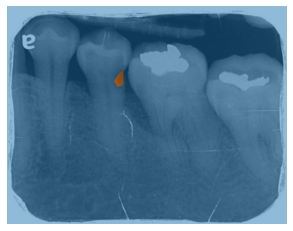

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


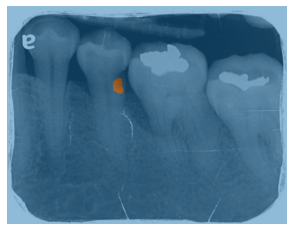

 16%|█▋        | 43/262 [05:29<28:47,  7.89s/it]

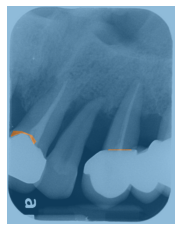

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 2


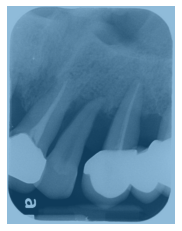

 17%|█▋        | 44/262 [05:36<28:17,  7.79s/it]

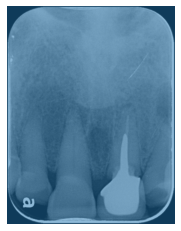

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


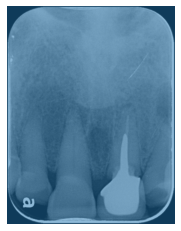

 17%|█▋        | 45/262 [05:44<27:50,  7.70s/it]

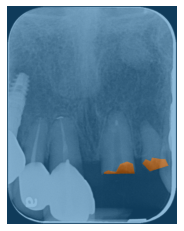

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 2


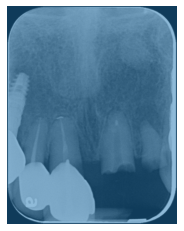

 18%|█▊        | 46/262 [05:52<28:10,  7.83s/it]

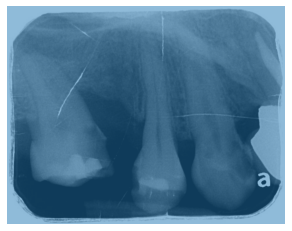

>>>>>>>>>>>>> TP: 0   FP: 2  gotP: 0  emptyP: 0


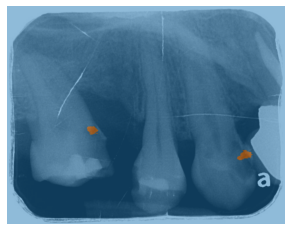

 18%|█▊        | 47/262 [06:00<28:05,  7.84s/it]

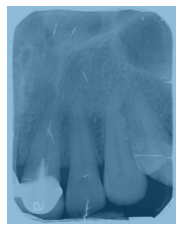

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


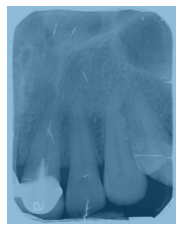

 18%|█▊        | 48/262 [06:08<27:57,  7.84s/it]

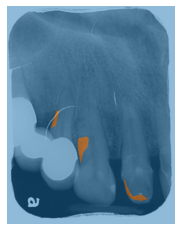

>>>>>>>>>>>>> TP: 1   FP: 1  gotP: 1  emptyP: 2


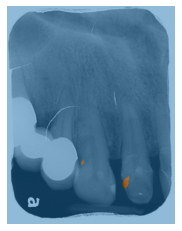

 19%|█▊        | 49/262 [06:16<28:02,  7.90s/it]

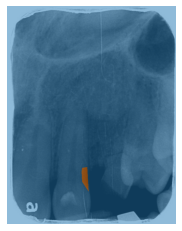

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 1


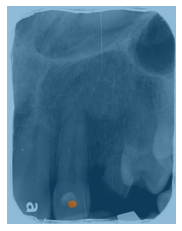

 19%|█▉        | 50/262 [06:23<27:34,  7.81s/it]

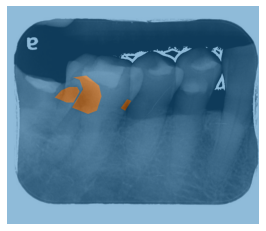

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 2


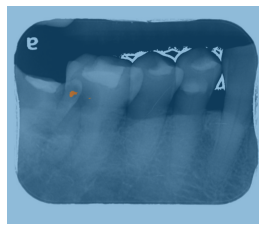

 19%|█▉        | 51/262 [06:31<27:32,  7.83s/it]

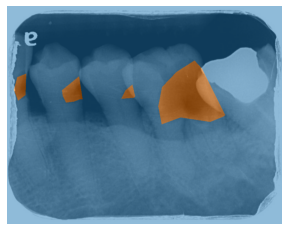

>>>>>>>>>>>>> TP: 2   FP: 1  gotP: 2  emptyP: 2


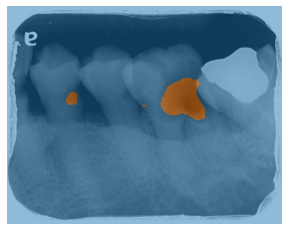

 20%|█▉        | 52/262 [06:39<27:37,  7.89s/it]

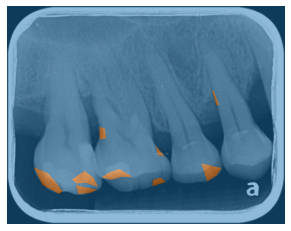

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 9


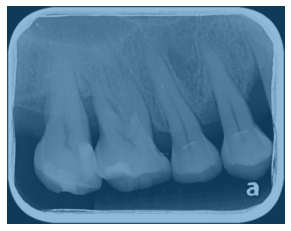

 20%|██        | 53/262 [06:47<27:23,  7.87s/it]

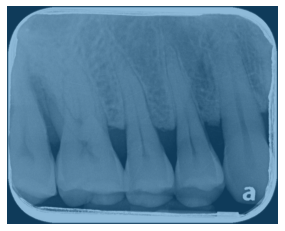

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


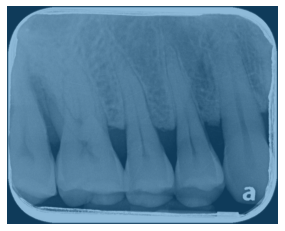

 21%|██        | 54/262 [06:55<27:04,  7.81s/it]

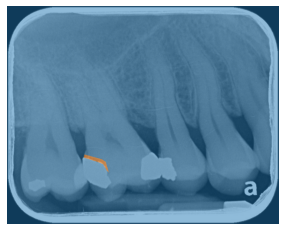

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


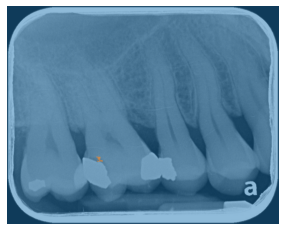

 21%|██        | 55/262 [07:02<26:40,  7.73s/it]

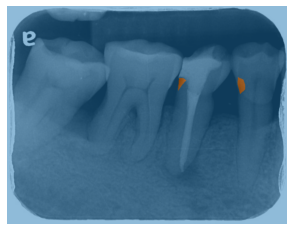

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 2


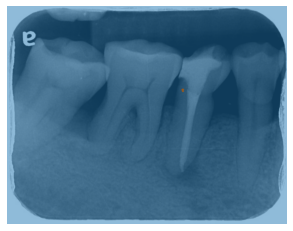

 21%|██▏       | 56/262 [07:10<26:39,  7.77s/it]

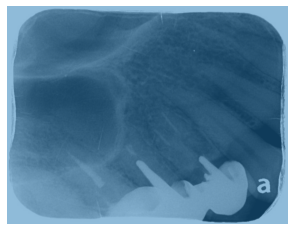

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


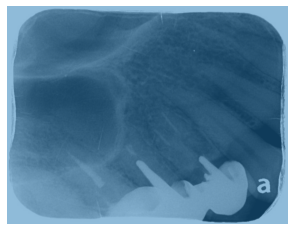

 22%|██▏       | 57/262 [07:18<26:21,  7.71s/it]

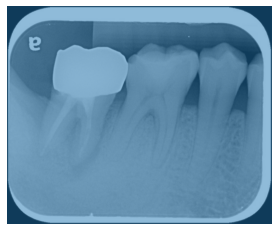

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


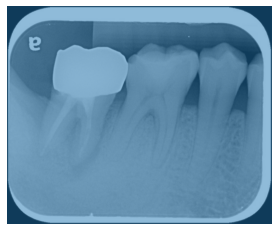

 22%|██▏       | 58/262 [07:26<26:37,  7.83s/it]

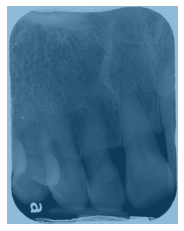

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


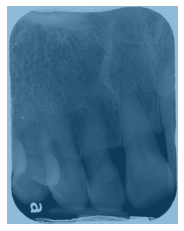

 23%|██▎       | 59/262 [07:33<26:14,  7.76s/it]

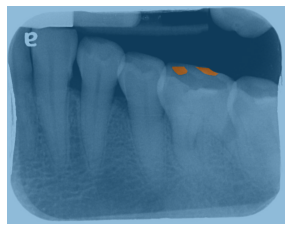

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 2


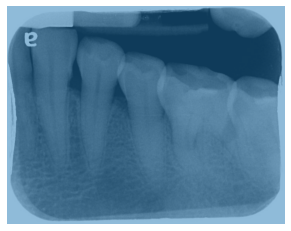

 23%|██▎       | 60/262 [07:41<26:00,  7.73s/it]

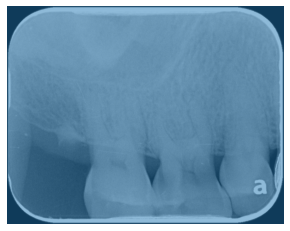

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


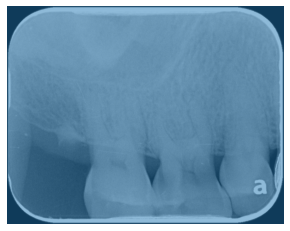

 23%|██▎       | 61/262 [07:49<25:41,  7.67s/it]

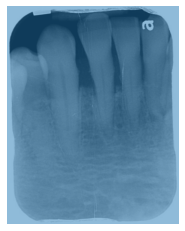

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 0


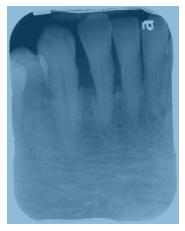

 24%|██▎       | 62/262 [07:56<25:25,  7.63s/it]

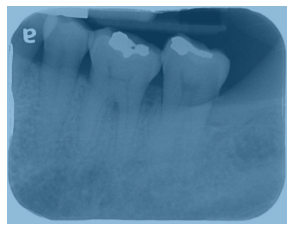

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


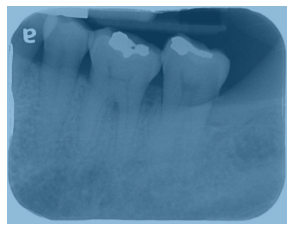

 24%|██▍       | 63/262 [08:04<25:09,  7.59s/it]

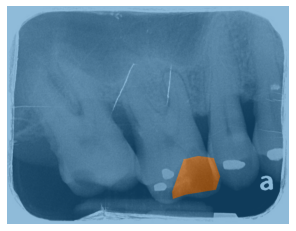

>>>>>>>>>>>>> TP: 1   FP: 1  gotP: 1  emptyP: 0


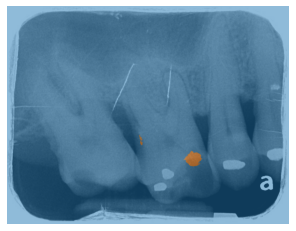

 24%|██▍       | 64/262 [08:11<25:04,  7.60s/it]

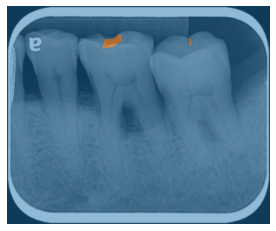

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 2


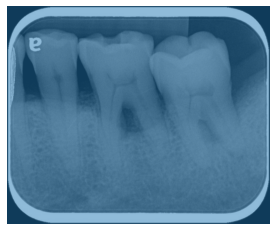

 25%|██▍       | 65/262 [08:19<25:11,  7.67s/it]

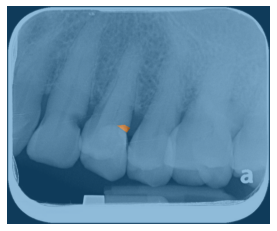

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 1


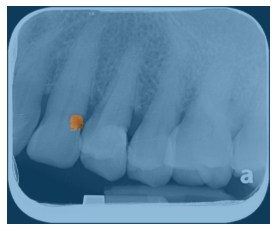

 25%|██▌       | 66/262 [08:27<24:58,  7.64s/it]

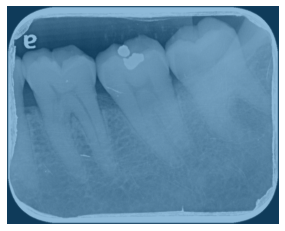

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


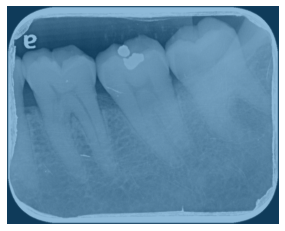

 26%|██▌       | 67/262 [08:34<24:44,  7.61s/it]

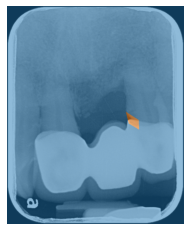

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


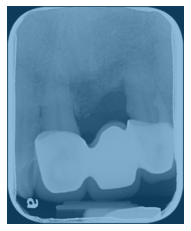

 26%|██▌       | 68/262 [08:42<24:32,  7.59s/it]

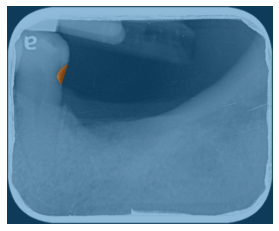

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


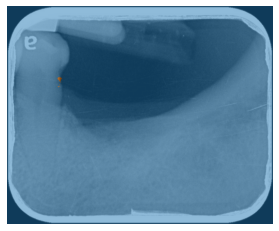

 26%|██▋       | 69/262 [08:49<24:23,  7.58s/it]

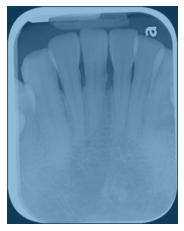

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


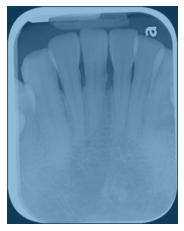

 27%|██▋       | 70/262 [08:57<24:21,  7.61s/it]

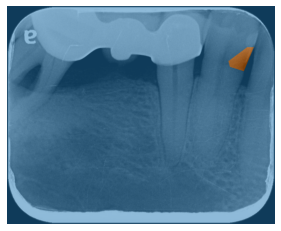

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 1


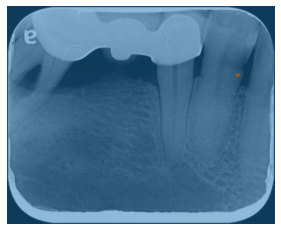

 27%|██▋       | 71/262 [09:05<24:27,  7.68s/it]

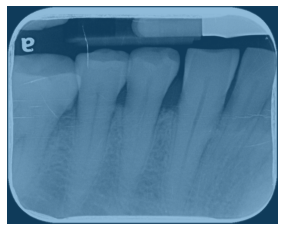

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


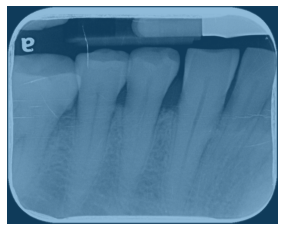

 27%|██▋       | 72/262 [09:12<24:15,  7.66s/it]

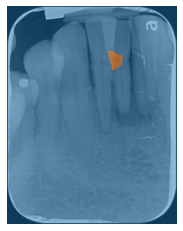

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


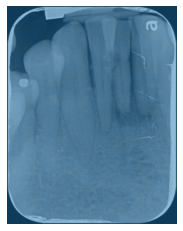

 28%|██▊       | 73/262 [09:20<24:02,  7.63s/it]

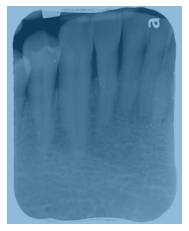

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


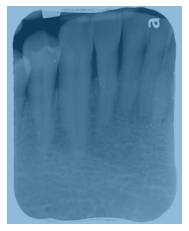

 28%|██▊       | 74/262 [09:28<23:58,  7.65s/it]

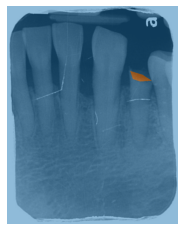

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 1


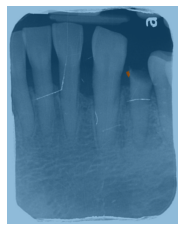

 29%|██▊       | 75/262 [09:35<23:51,  7.65s/it]

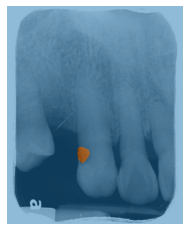

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


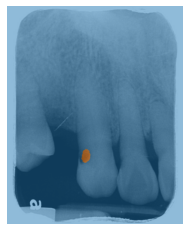

 29%|██▉       | 76/262 [09:43<24:00,  7.74s/it]

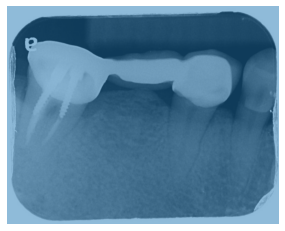

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 0


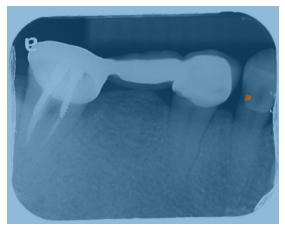

 29%|██▉       | 77/262 [09:51<23:39,  7.67s/it]

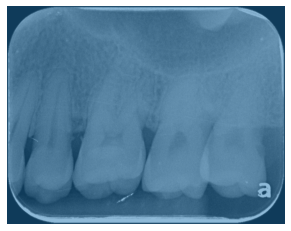

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


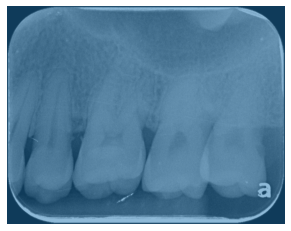

 30%|██▉       | 78/262 [09:59<23:56,  7.81s/it]

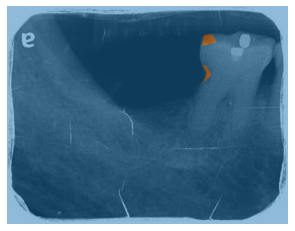

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 1


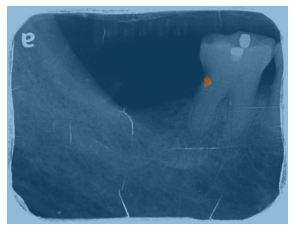

 30%|███       | 79/262 [10:07<24:03,  7.89s/it]

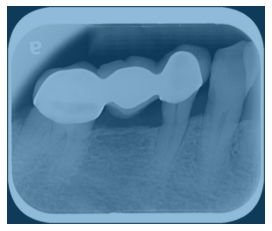

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


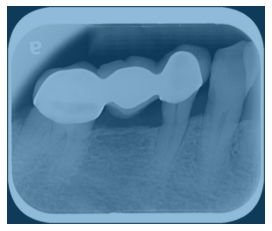

 31%|███       | 80/262 [10:15<24:07,  7.95s/it]

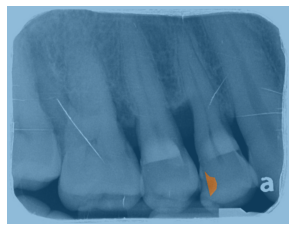

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 1


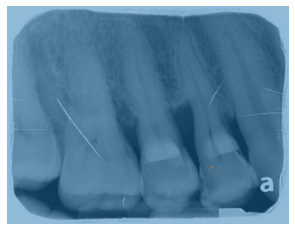

 31%|███       | 81/262 [10:23<23:48,  7.89s/it]

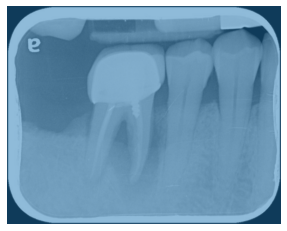

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


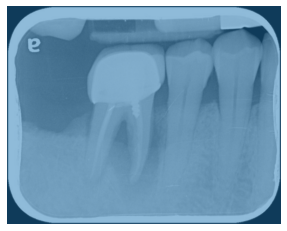

 31%|███▏      | 82/262 [10:31<23:35,  7.87s/it]

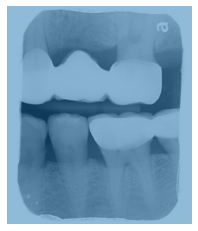

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


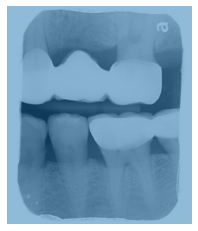

 32%|███▏      | 83/262 [10:39<23:23,  7.84s/it]

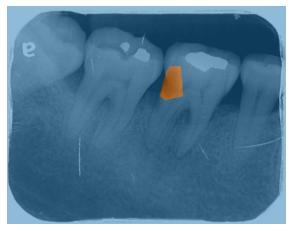

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


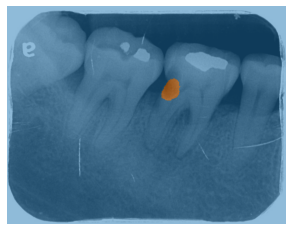

 32%|███▏      | 84/262 [10:46<23:05,  7.79s/it]

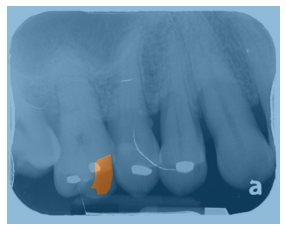

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


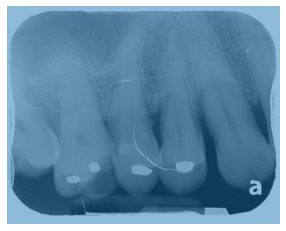

 32%|███▏      | 85/262 [10:54<22:52,  7.76s/it]

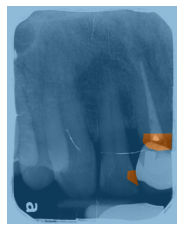

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 2


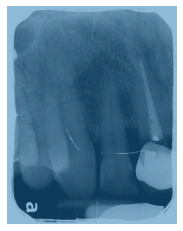

 33%|███▎      | 86/262 [11:02<22:50,  7.79s/it]

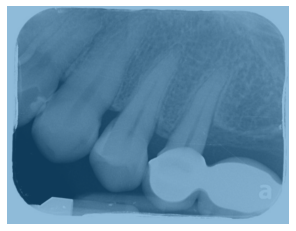

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


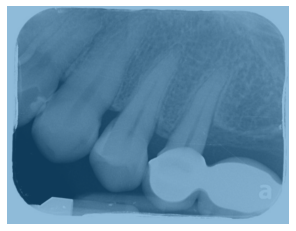

 33%|███▎      | 87/262 [11:09<22:37,  7.76s/it]

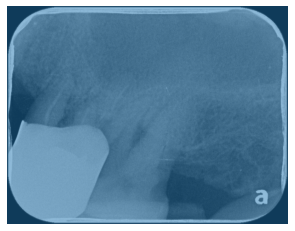

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 0


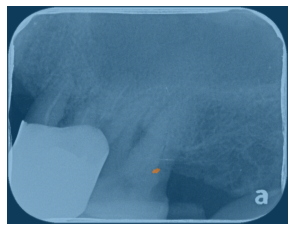

 34%|███▎      | 88/262 [11:17<22:25,  7.73s/it]

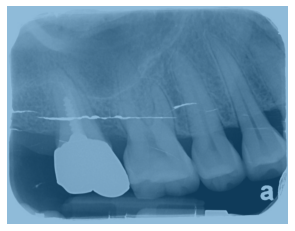

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


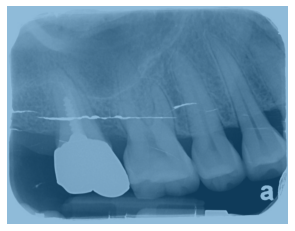

 34%|███▍      | 89/262 [11:25<22:17,  7.73s/it]

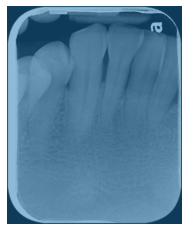

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


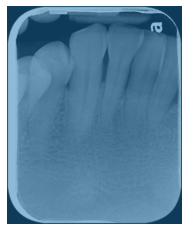

 34%|███▍      | 90/262 [11:32<22:05,  7.71s/it]

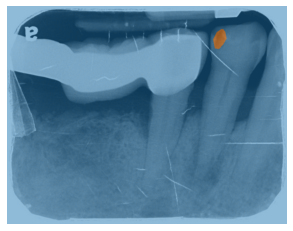

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


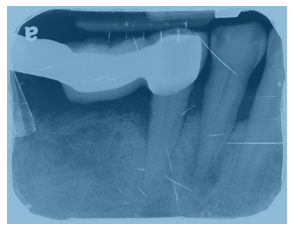

 35%|███▍      | 91/262 [11:40<21:56,  7.70s/it]

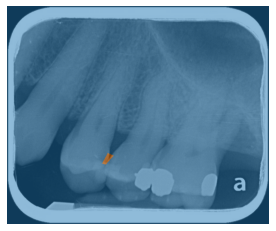

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


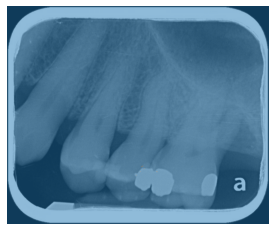

 35%|███▌      | 92/262 [11:48<21:46,  7.68s/it]

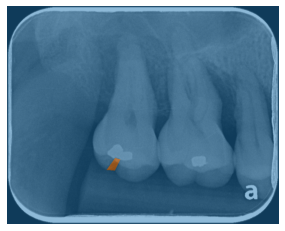

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


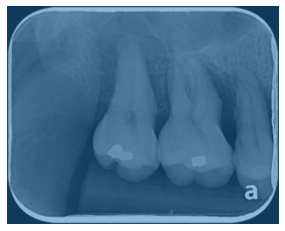

 35%|███▌      | 93/262 [11:55<21:36,  7.67s/it]

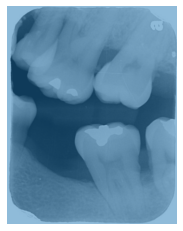

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 0


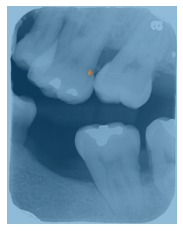

 36%|███▌      | 94/262 [12:03<21:26,  7.66s/it]

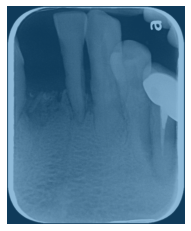

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


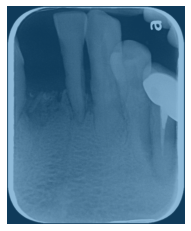

 36%|███▋      | 95/262 [12:11<21:44,  7.81s/it]

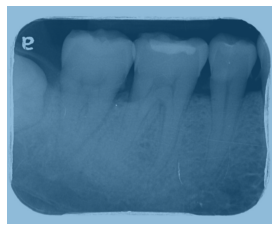

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 0


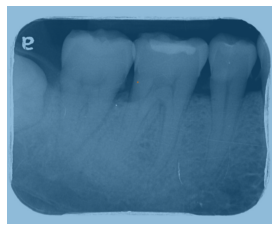

 37%|███▋      | 96/262 [12:19<21:28,  7.76s/it]

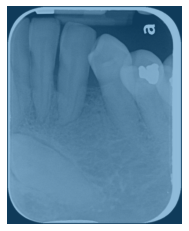

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


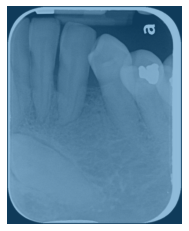

 37%|███▋      | 97/262 [12:27<21:20,  7.76s/it]

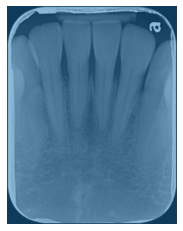

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


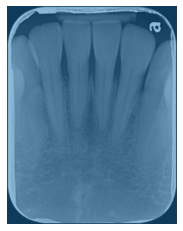

 37%|███▋      | 98/262 [12:35<21:29,  7.86s/it]

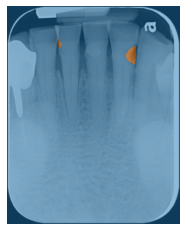

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 2


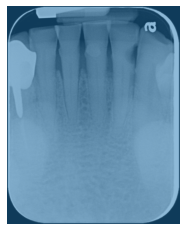

 38%|███▊      | 99/262 [12:43<21:36,  7.95s/it]

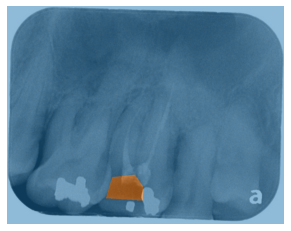

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


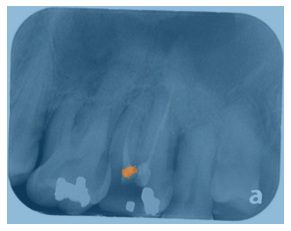

 38%|███▊      | 100/262 [12:51<21:33,  7.98s/it]

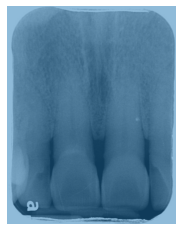

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 0


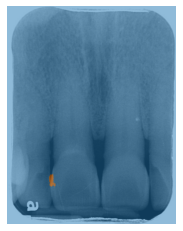

 39%|███▊      | 101/262 [12:59<21:22,  7.97s/it]

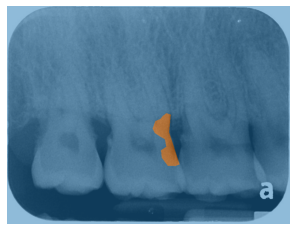

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


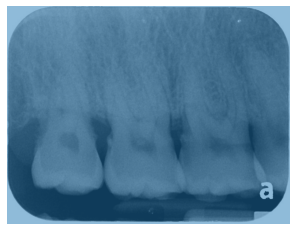

 39%|███▉      | 102/262 [13:07<21:18,  7.99s/it]

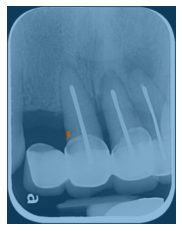

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


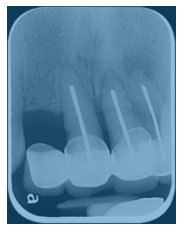

 39%|███▉      | 103/262 [13:15<21:01,  7.93s/it]

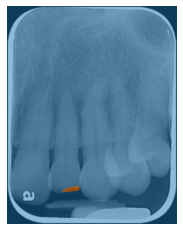

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


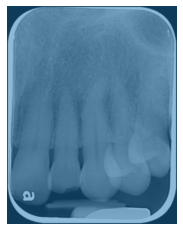

 40%|███▉      | 104/262 [13:22<20:40,  7.85s/it]

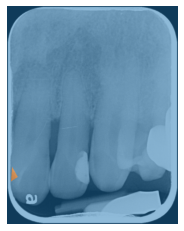

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


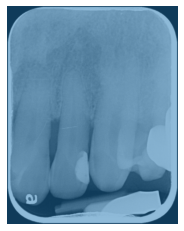

 40%|████      | 105/262 [13:30<20:27,  7.82s/it]

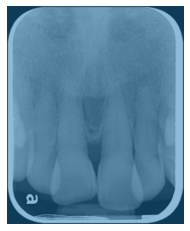

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


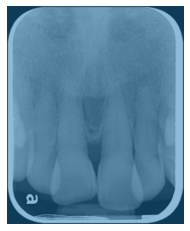

 40%|████      | 106/262 [13:38<20:20,  7.82s/it]

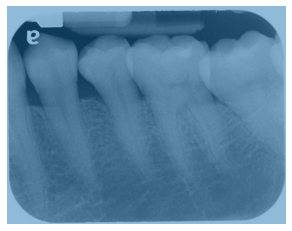

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


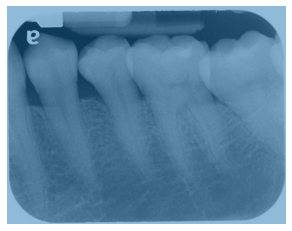

 41%|████      | 107/262 [13:46<20:09,  7.81s/it]

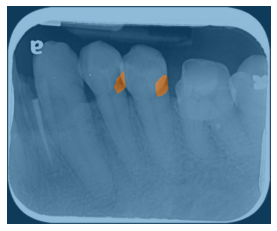

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 1


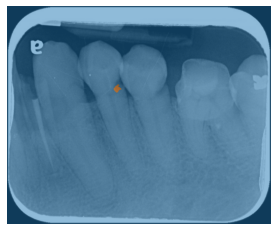

 41%|████      | 108/262 [13:53<20:00,  7.80s/it]

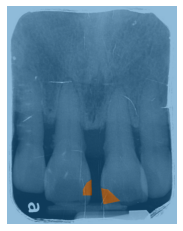

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 2


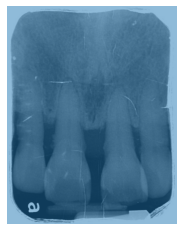

 42%|████▏     | 109/262 [14:01<19:48,  7.77s/it]

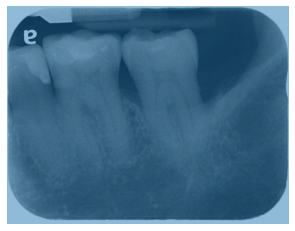

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


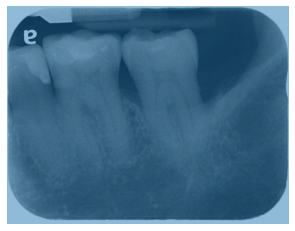

 42%|████▏     | 110/262 [14:09<19:40,  7.77s/it]

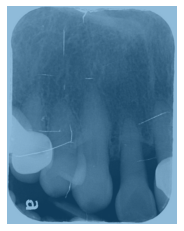

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


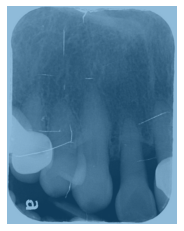

 42%|████▏     | 111/262 [14:17<19:35,  7.79s/it]

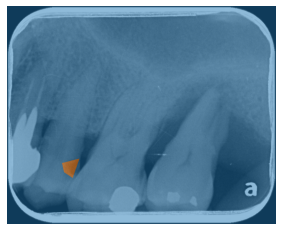

>>>>>>>>>>>>> TP: 0   FP: 2  gotP: 0  emptyP: 1


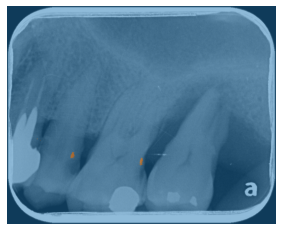

 43%|████▎     | 112/262 [14:25<19:36,  7.84s/it]

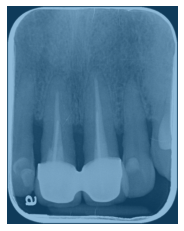

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


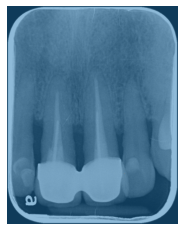

 43%|████▎     | 113/262 [14:33<19:28,  7.84s/it]

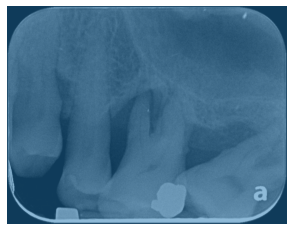

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


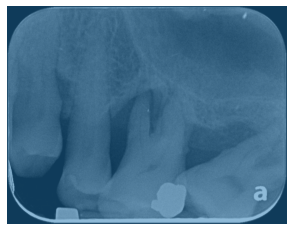

 44%|████▎     | 114/262 [14:41<19:39,  7.97s/it]

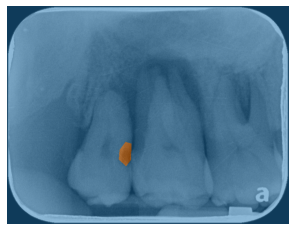

>>>>>>>>>>>>> TP: 1   FP: 1  gotP: 1  emptyP: 0


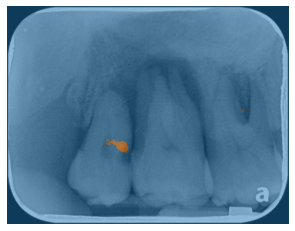

 44%|████▍     | 115/262 [14:49<19:22,  7.91s/it]

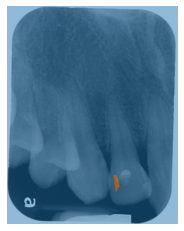

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


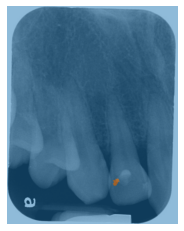

 44%|████▍     | 116/262 [14:56<19:05,  7.85s/it]

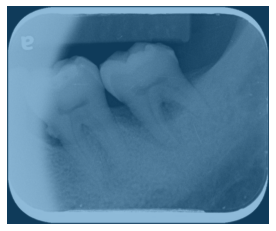

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


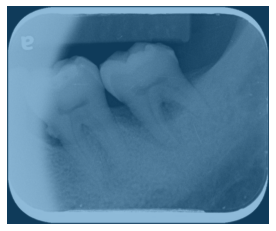

 45%|████▍     | 117/262 [15:04<18:56,  7.84s/it]

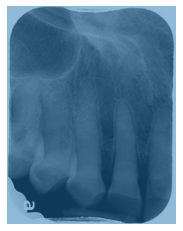

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


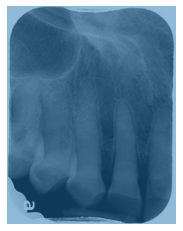

 45%|████▌     | 118/262 [15:12<18:53,  7.87s/it]

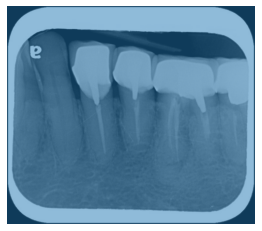

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


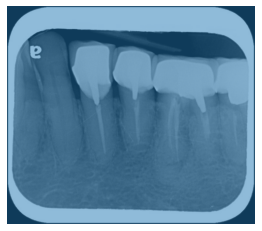

 45%|████▌     | 119/262 [15:20<19:07,  8.03s/it]

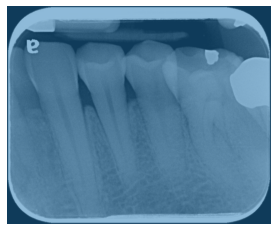

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


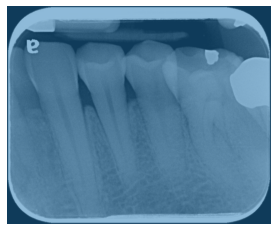

 46%|████▌     | 120/262 [15:29<19:26,  8.21s/it]

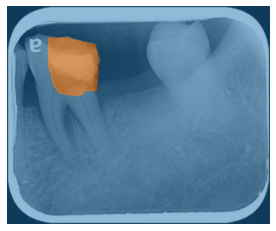

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


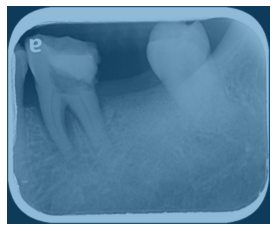

 46%|████▌     | 121/262 [15:38<19:31,  8.31s/it]

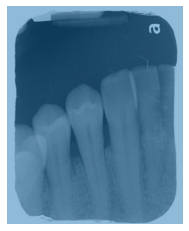

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


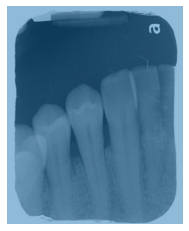

 47%|████▋     | 122/262 [15:46<19:32,  8.38s/it]

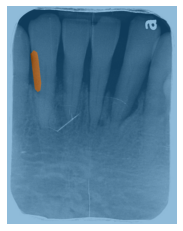

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


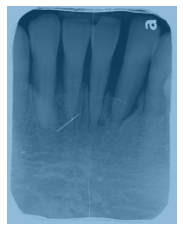

 47%|████▋     | 123/262 [15:55<19:32,  8.44s/it]

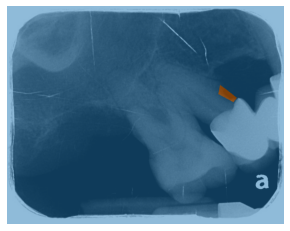

>>>>>>>>>>>>> TP: 0   FP: 2  gotP: 0  emptyP: 1


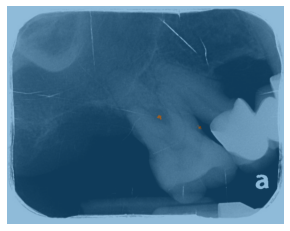

 47%|████▋     | 124/262 [16:03<19:13,  8.36s/it]

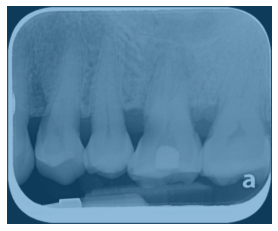

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


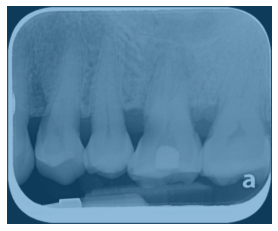

 48%|████▊     | 125/262 [16:11<19:12,  8.41s/it]

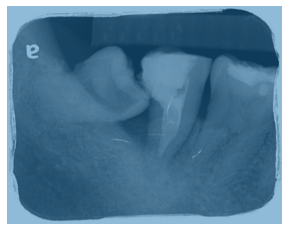

>>>>>>>>>>>>> TP: 0   FP: 2  gotP: 0  emptyP: 0


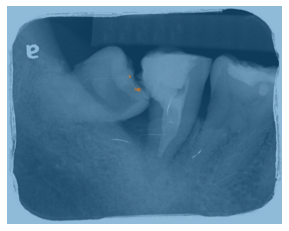

 48%|████▊     | 126/262 [16:20<19:08,  8.44s/it]

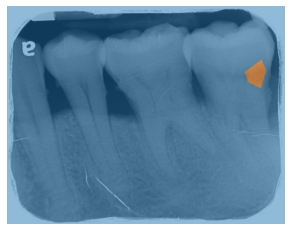

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


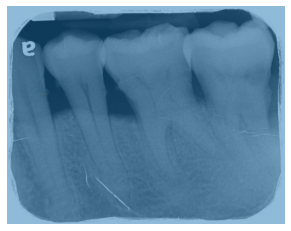

 48%|████▊     | 127/262 [16:29<19:04,  8.48s/it]

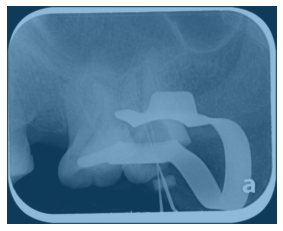

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


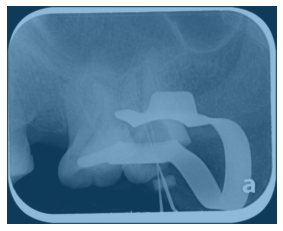

 49%|████▉     | 128/262 [16:37<19:05,  8.55s/it]

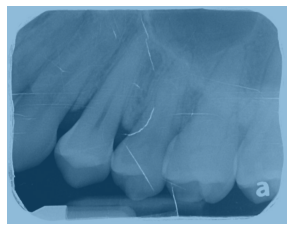

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


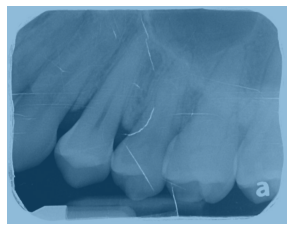

 49%|████▉     | 129/262 [16:45<18:31,  8.36s/it]

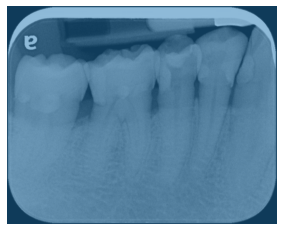

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


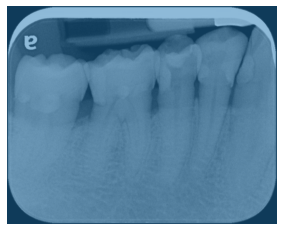

 50%|████▉     | 130/262 [16:53<18:10,  8.26s/it]

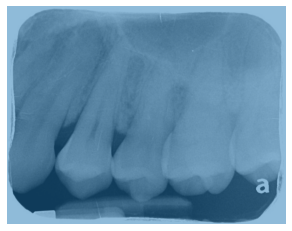

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


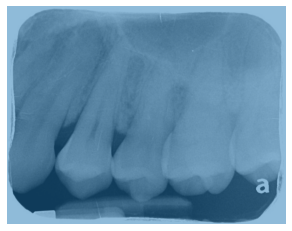

 50%|█████     | 131/262 [17:01<17:48,  8.16s/it]

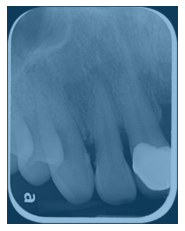

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


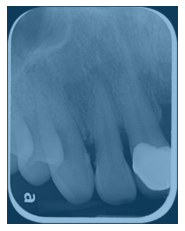

 50%|█████     | 132/262 [17:10<18:15,  8.42s/it]

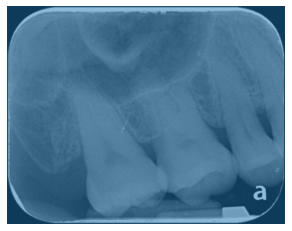

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


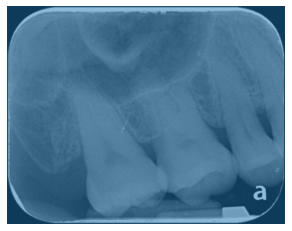

 51%|█████     | 133/262 [17:18<17:45,  8.26s/it]

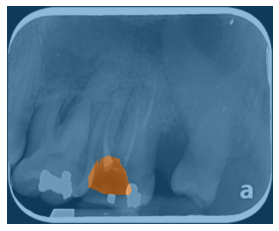

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


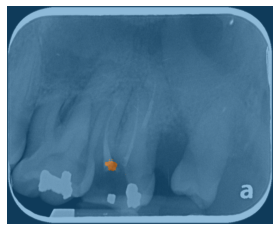

 51%|█████     | 134/262 [17:26<17:26,  8.17s/it]

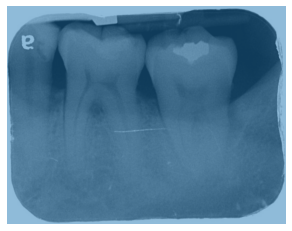

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


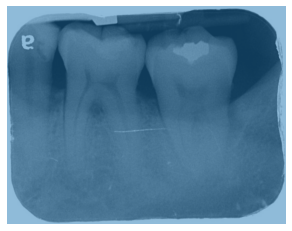

 52%|█████▏    | 135/262 [17:34<17:20,  8.19s/it]

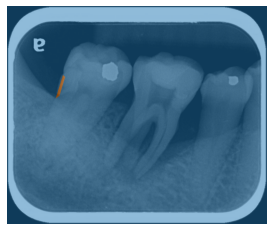

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 1


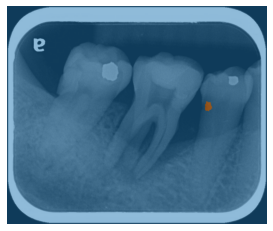

 52%|█████▏    | 136/262 [17:42<17:04,  8.13s/it]

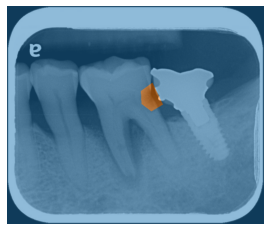

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


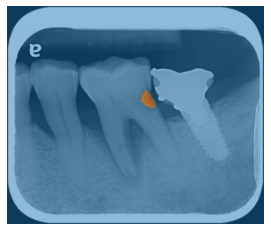

 52%|█████▏    | 137/262 [17:50<16:47,  8.06s/it]

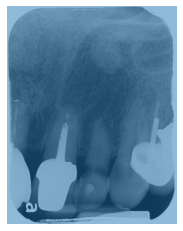

>>>>>>>>>>>>> TP: 0   FP: 2  gotP: 0  emptyP: 0


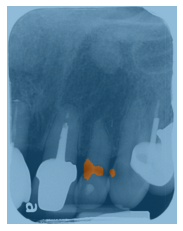

 53%|█████▎    | 138/262 [17:58<16:35,  8.03s/it]

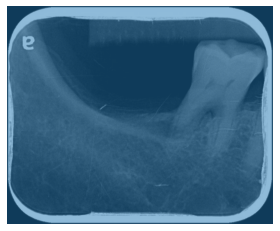

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


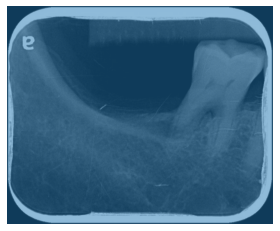

 53%|█████▎    | 139/262 [18:06<16:30,  8.05s/it]

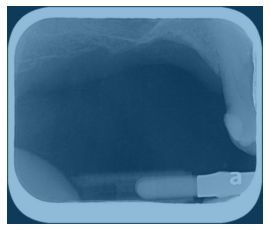

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


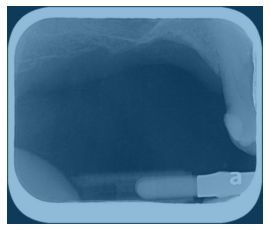

 53%|█████▎    | 140/262 [18:14<16:24,  8.07s/it]

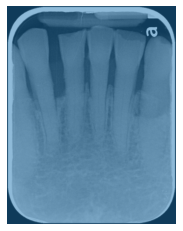

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


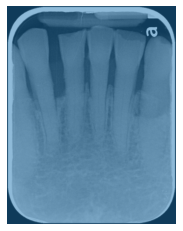

 54%|█████▍    | 141/262 [18:23<16:27,  8.16s/it]

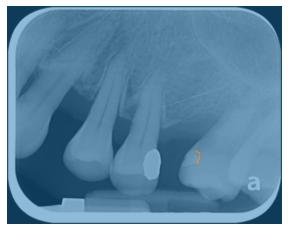

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


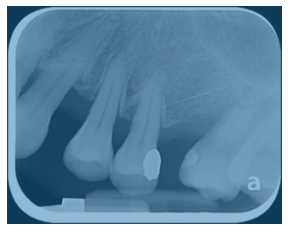

 54%|█████▍    | 142/262 [18:31<16:21,  8.18s/it]

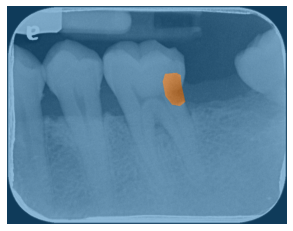

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


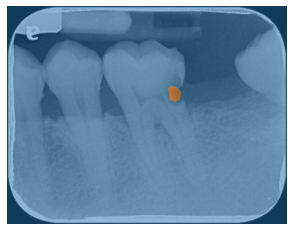

 55%|█████▍    | 143/262 [18:39<16:12,  8.17s/it]

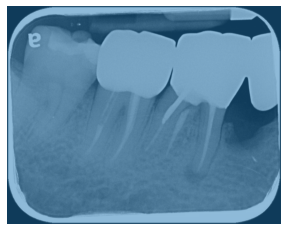

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


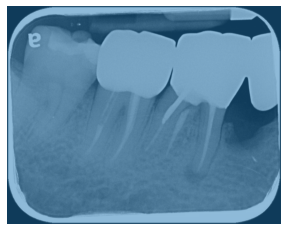

 55%|█████▍    | 144/262 [18:47<16:02,  8.16s/it]

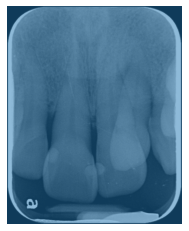

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


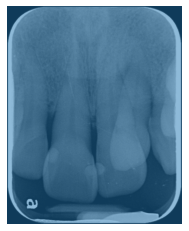

 55%|█████▌    | 145/262 [18:56<16:08,  8.28s/it]

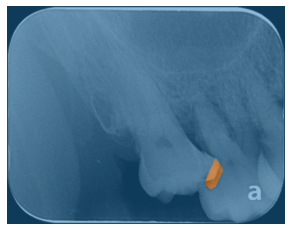

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


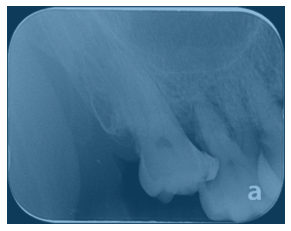

 56%|█████▌    | 146/262 [19:04<16:05,  8.32s/it]

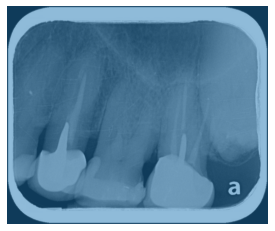

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 0


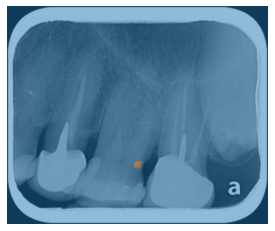

 56%|█████▌    | 147/262 [19:13<15:57,  8.32s/it]

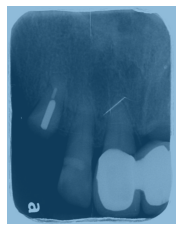

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


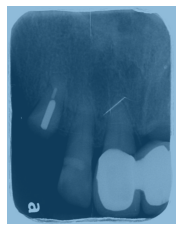

 56%|█████▋    | 148/262 [19:21<15:50,  8.34s/it]

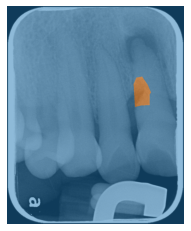

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


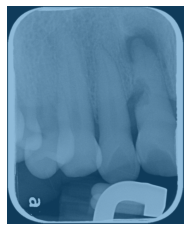

 57%|█████▋    | 149/262 [19:29<15:38,  8.31s/it]

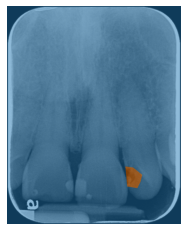

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


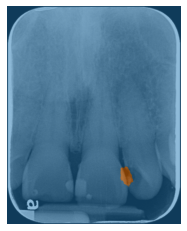

 57%|█████▋    | 150/262 [19:38<15:32,  8.33s/it]

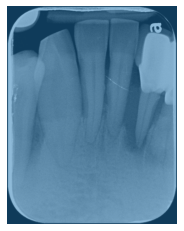

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


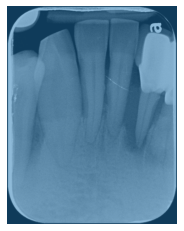

 58%|█████▊    | 151/262 [19:46<15:33,  8.41s/it]

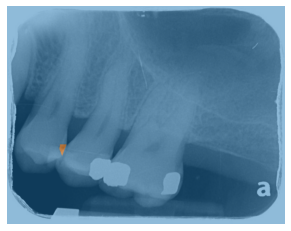

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


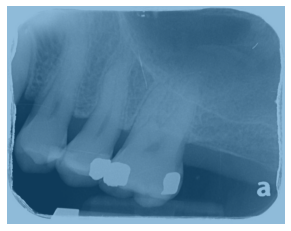

 58%|█████▊    | 152/262 [19:55<15:28,  8.44s/it]

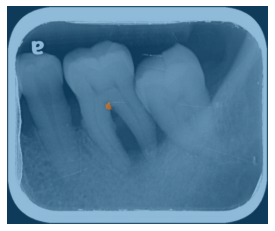

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


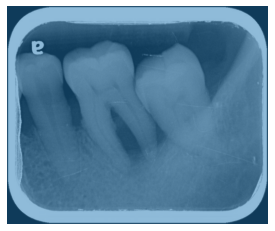

 58%|█████▊    | 153/262 [20:04<15:36,  8.59s/it]

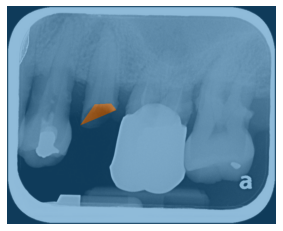

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


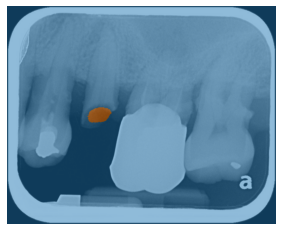

 59%|█████▉    | 154/262 [20:14<16:35,  9.22s/it]

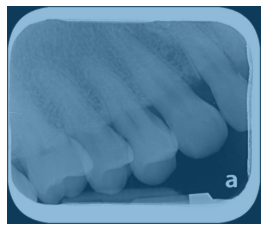

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


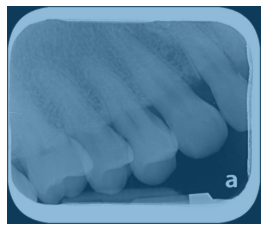

 59%|█████▉    | 155/262 [20:26<17:44,  9.95s/it]

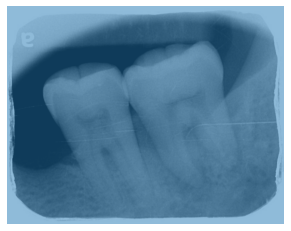

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


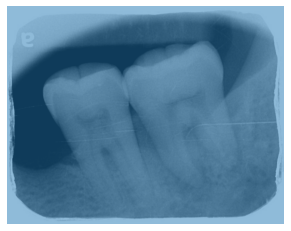

 60%|█████▉    | 156/262 [20:34<16:43,  9.47s/it]

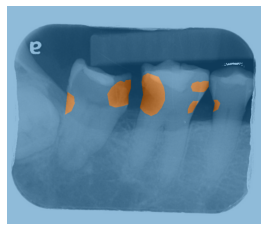

>>>>>>>>>>>>> TP: 2   FP: 0  gotP: 2  emptyP: 4


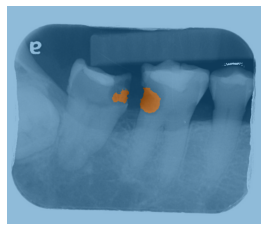

 60%|█████▉    | 157/262 [20:43<16:16,  9.30s/it]

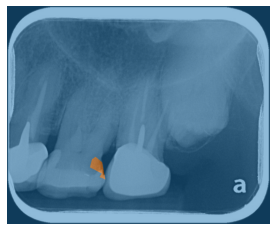

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


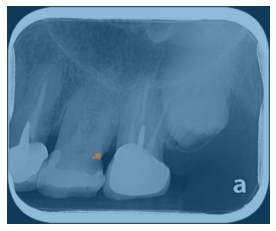

 60%|██████    | 158/262 [20:53<16:27,  9.50s/it]

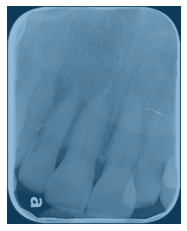

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


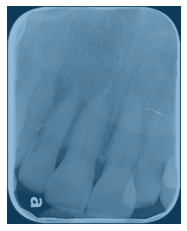

 61%|██████    | 159/262 [21:03<16:37,  9.68s/it]

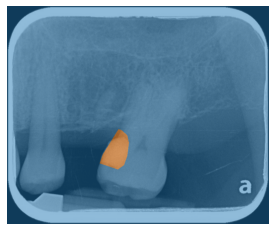

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


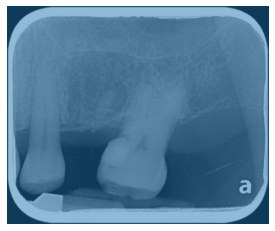

 61%|██████    | 160/262 [21:15<17:20, 10.20s/it]

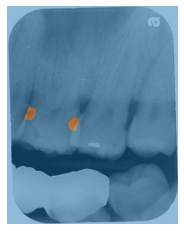

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 1


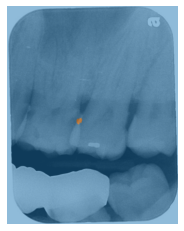

 61%|██████▏   | 161/262 [21:26<17:41, 10.51s/it]

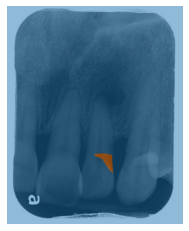

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 1


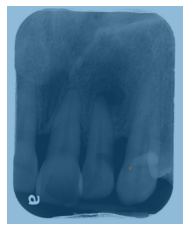

 62%|██████▏   | 162/262 [21:38<18:23, 11.04s/it]

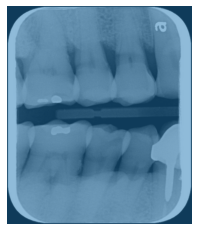

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


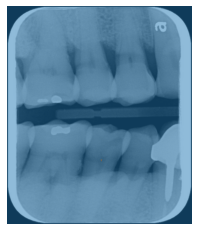

 62%|██████▏   | 163/262 [21:49<18:10, 11.01s/it]

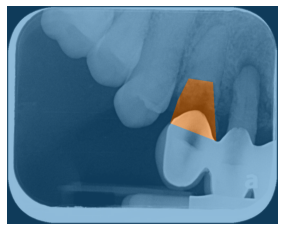

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


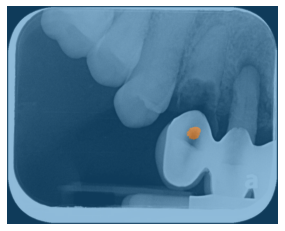

 63%|██████▎   | 164/262 [22:01<18:17, 11.20s/it]

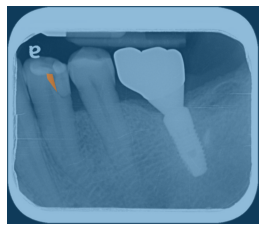

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 1


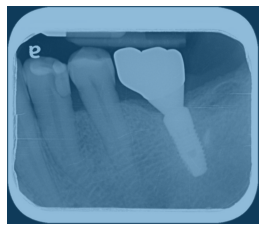

 63%|██████▎   | 165/262 [22:13<18:37, 11.52s/it]

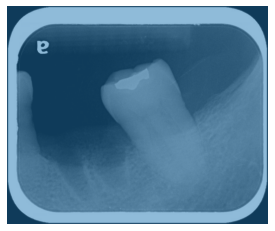

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


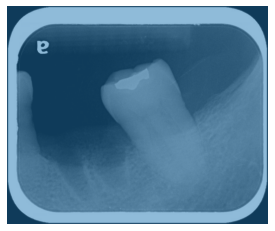

 63%|██████▎   | 166/262 [22:24<18:23, 11.49s/it]

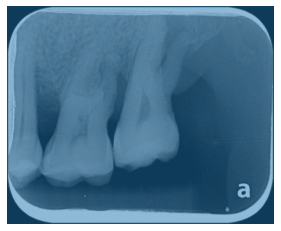

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


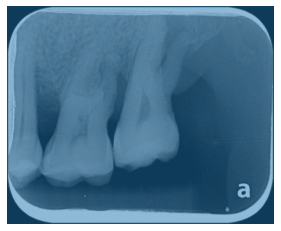

 64%|██████▎   | 167/262 [22:37<18:39, 11.78s/it]

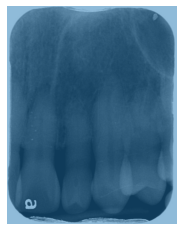

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


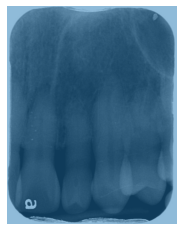

 64%|██████▍   | 168/262 [22:49<18:45, 11.98s/it]

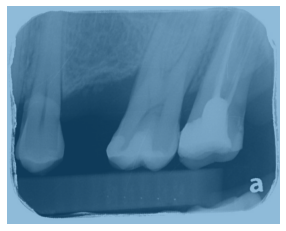

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


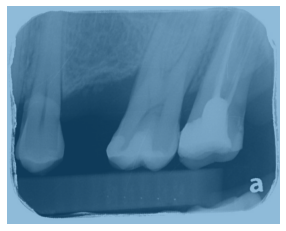

 65%|██████▍   | 169/262 [23:01<18:36, 12.00s/it]

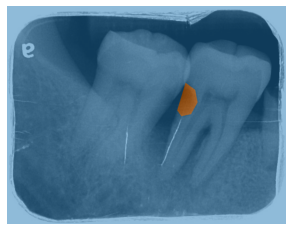

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


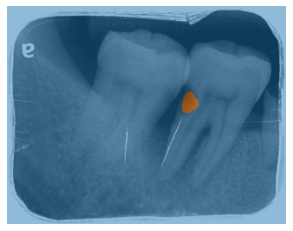

 65%|██████▍   | 170/262 [23:10<16:45, 10.93s/it]

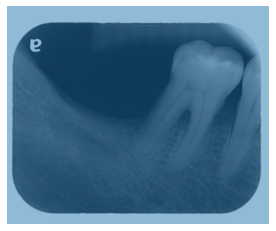

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


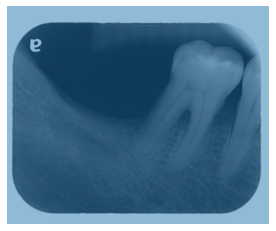

 65%|██████▌   | 171/262 [23:18<15:29, 10.22s/it]

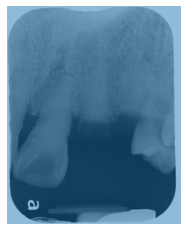

>>>>>>>>>>>>> TP: 0   FP: 2  gotP: 0  emptyP: 0


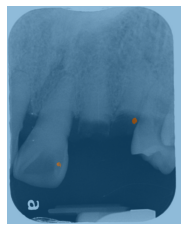

 66%|██████▌   | 172/262 [23:27<14:44,  9.83s/it]

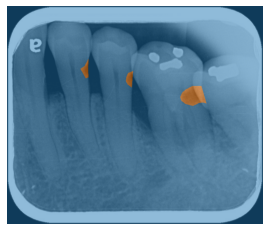

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 2


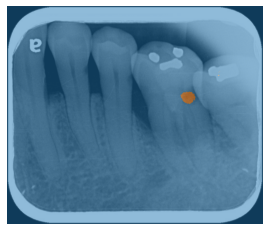

 66%|██████▌   | 173/262 [23:36<14:09,  9.55s/it]

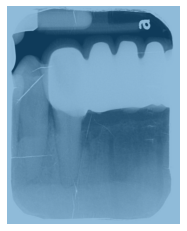

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


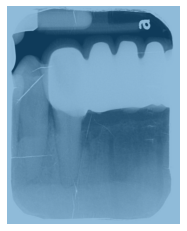

 66%|██████▋   | 174/262 [23:45<13:31,  9.22s/it]

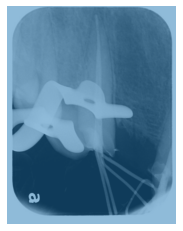

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


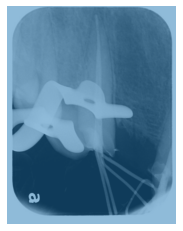

 67%|██████▋   | 175/262 [23:53<13:08,  9.06s/it]

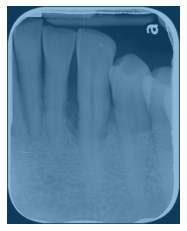

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


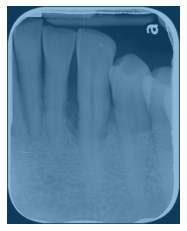

 67%|██████▋   | 176/262 [24:02<12:47,  8.92s/it]

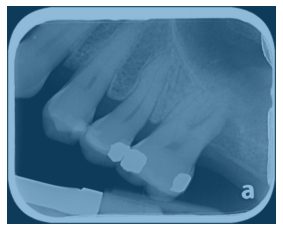

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


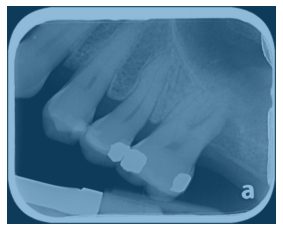

 68%|██████▊   | 177/262 [24:11<12:30,  8.83s/it]

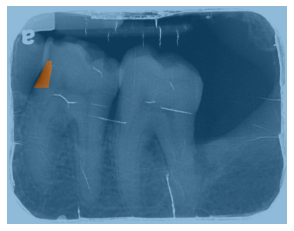

>>>>>>>>>>>>> TP: 1   FP: 0  gotP: 1  emptyP: 0


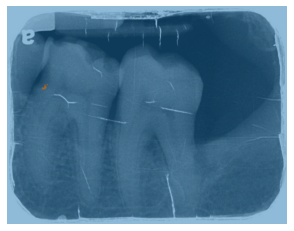

 68%|██████▊   | 178/262 [24:19<12:12,  8.72s/it]

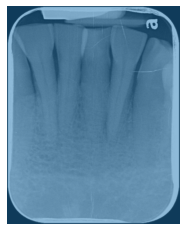

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


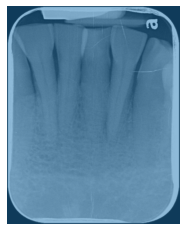

 68%|██████▊   | 179/262 [24:28<12:00,  8.68s/it]

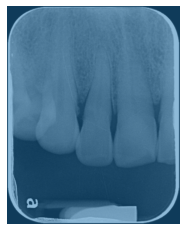

>>>>>>>>>>>>> TP: 0   FP: 0  gotP: 0  emptyP: 0


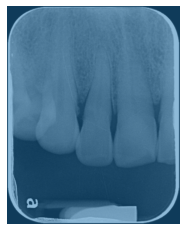

 69%|██████▊   | 180/262 [24:36<11:44,  8.59s/it]

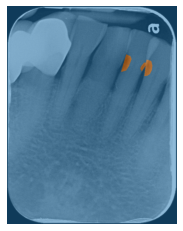

>>>>>>>>>>>>> TP: 0   FP: 1  gotP: 0  emptyP: 2


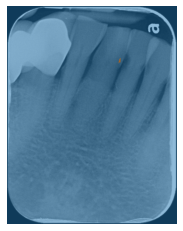

 69%|██████▉   | 181/262 [24:45<11:04,  8.20s/it]

 
----------------------------------------------------------------------------
	> Num 70 -- TP: 29 - FP: 41 - include: 29 - empty: 99
----------------------------------------------------------------------------
 > Accuracy: 41.43%
----------------------------------------------------------------------------


TypeError: ignored

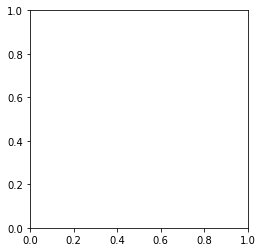

In [ ]:
img=predictt(5365)
plt.imshow(img)
plt.axis('off')
plt.show()